In [ ]:
import pandas as pd

In [ ]:
df = pd.read_csv('/content/historical_raw_data.csv')

In [ ]:
df

,Fight ID,Event Title,Event Date,Event Location,Weight Class,Winning Method,Winning Round,Winning Time,Winner First Name,Winner Last Name,...,Round 5 Significant Strike Head Landed,Round 5 Significant Strike Body Attempted,Round 5 Significant Strike Body Landed,Round 5 Significant Strike Leg Attempted,Round 5 Significant Strike Leg Landed,Round 5 Significant Strike Clinch Attempted,Round 5 Significant Strike Clinch Landed,Round 5 Significant Strike Ground Attempted,Round 5 Significant Strike Ground Landed,odds
0,1,UFC on FX: Guillard vs Miller,20-01-2012,"Nashville, Tennessee, USA",Bantamweight,KO/TKO,1.0,0.22,Nick,Denis,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,236.00
1,1,UFC on FX: Guillard vs Miller,20-01-2012,"Nashville, Tennessee, USA",Bantamweight,KO/TKO,1.0,0.22,Nick,Denis,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-292.86
2,2,UFC on FX: Guillard vs Miller,20-01-2012,"Nashville, Tennessee, USA",Featherweight,SUB,1.0,1.37,Daniel,Pineda,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,119.14
3,2,UFC on FX: Guillard vs Miller,20-01-2012,"Nashville, Tennessee, USA",Featherweight,SUB,1.0,1.37,Daniel,Pineda,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-143.71
4,3,UFC on FX: Guillard vs Miller,20-01-2012,"Nashville, Tennessee, USA",Lightweight,SUB,1.0,4.03,Fabricio,Camoes,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,262.86
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12503,6252,UFC Fight Night: Vettori vs. Dolidze 2,15-03-2025,"Las Vegas, Nevada, USA",Women's Bantamweight,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
12504,6253,UFC Fight Night: Vettori vs. Dolidze 2,15-03-2025,"Las Vegas, Nevada, USA",Lightweight,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
12505,6253,UFC Fight Night: Vettori vs. Dolidze 2,15-03-2025,"Las Vegas, Nevada, USA",Lightweight,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
12506,6254,UFC Fight Night: Vettori vs. Dolidze 2,15-03-2025,"Las Vegas, Nevada, USA",Women's Flyweight,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
import pandas as pd

def calculate_cumulative_winner_avg(df, col_name, fighter_first_name, fighter_last_name,
                                   fighter_first_col='Fighter First Name', fighter_last_col='Fighter Last Name',
                                   winner_first_col='Winner First Name', winner_last_col='Winner Last Name'):
    # specified fighter
    fighter_df = df[(df[fighter_first_col] == fighter_first_name) & (df[fighter_last_col] == fighter_last_name)].copy()

    if len(fighter_df) == 0:
        return pd.Series([], dtype=float, name=f'Cumulative_{col_name}_Avg_Prev_Wins')

    result = []
    wins_values = []
    fight_ids = fighter_df['Fight ID'].values

    for idx in range(len(fighter_df)):
        # if the fighter won the current fight
        row = fighter_df.iloc[idx]
        is_winner = (row[fighter_first_col] == row[winner_first_col]) and \
                    (row[fighter_last_col] == row[winner_last_col])

        if idx == 0:
            result.append(0)
        else:
            if len(wins_values) == 0:
                result.append(0)
            else:
                result.append(sum(wins_values) / len(wins_values))

        if is_winner:
            wins_values.append(row[col_name])

    # with  ID as the index
    return pd.Series(result, index=fight_ids, name=f'Cumulative_{col_name}_Avg_Prev_Wins')

test = calculate_cumulative_winner_avg(df, 'Significant Strike Total Attempted', 'Daniel', 'Pineda')

In [ ]:
test = calculate_cumulative_winner_avg(df, 'Significant Strike Total Attempted', 'Daniel', 'Pineda')

In [ ]:
test

,Cumulative_Significant Strike Total Attempted_Avg_Prev_Wins
2,0.000000
54,24.000000
112,18.000000
192,18.000000
425,18.000000
546,12.666667
803,12.666667
3894,12.666667
4072,15.000000
4344,15.000000


In [ ]:
import pandas as pd
import numpy as np

def calculate_stats_for_column(df, col_name, fighter_first_col='Fighter First Name', fighter_last_col='Fighter Last Name',
                              winner_first_col='Winner First Name', winner_last_col='Winner Last Name'):

    stats_dict = {
        f'{col_name}_Wins': [],
        f'Avg_{col_name}_Wins': [],
        f'{col_name}_Losses': [],
        f'Avg_{col_name}_Losses': [],
        f'{col_name}_Wins_KO_TKO': [],
        f'Avg_{col_name}_Wins_KO_TKO': [],
        f'{col_name}_Wins_SUB': [],
        f'Avg_{col_name}_Wins_SUB': [],
        f'{col_name}_Losses_U_DEC': [],
        f'Avg_{col_name}_Losses_U_DEC': [],
        f'{col_name}_Losses_KO_TKO': [],
        f'Avg_{col_name}_Losses_KO_TKO': [],
        f'{col_name}_CNC': [],
        f'Avg_{col_name}_CNC': [],
        f'Rolling_Avg_3_{col_name}': [],
        f'Rolling_Avg_5_{col_name}': [],
        f'Total_{col_name}_Last_5': [],
        f'Avg_{col_name}_Last_5': [],
        f'Total_{col_name}_Last_3': [],
        f'Avg_{col_name}_Last_3': []
    }

    for idx in range(len(df)):
        # current fighter and fight ID
        fighter_first = df.iloc[idx][fighter_first_col]
        fighter_last = df.iloc[idx][fighter_last_col]
        current_fight_id = df.iloc[idx]['Fight ID']

        # previous fights of this fighter
        fighter_prev_fights = df[
            (df[fighter_first_col] == fighter_first) &
            (df[fighter_last_col] == fighter_last) &
            (df['Fight ID'] < current_fight_id)
        ].sort_values(by='Fight ID')

        #  no previous fights, 0
        if len(fighter_prev_fights) == 0:
            for stat in stats_dict:
                stats_dict[stat].append(0)
            continue

        # values for the specified column
        values = fighter_prev_fights[col_name].astype(float).values

        # Win/Loss Stats
        wins = fighter_prev_fights[
            (fighter_prev_fights[fighter_first_col] == fighter_prev_fights[winner_first_col]) &
            (fighter_prev_fights[fighter_last_col] == fighter_prev_fights[winner_last_col])
        ]
        losses = fighter_prev_fights[
            (fighter_prev_fights[fighter_first_col] != fighter_prev_fights[winner_first_col]) |
            (fighter_prev_fights[fighter_last_col] != fighter_prev_fights[winner_last_col])
        ]
        wins_values = wins[col_name].astype(float).values
        losses_values = losses[col_name].astype(float).values

        total_wins = np.sum(wins_values) if len(wins_values) > 0 else 0
        avg_wins = np.mean(wins_values) if len(wins_values) > 0 else 0
        total_losses = np.sum(losses_values) if len(losses_values) > 0 else 0
        avg_losses = np.mean(losses_values) if len(losses_values) > 0 else 0

        # Wins by KO/TKO and Submission
        wins_ko_tko = wins[wins['Winning Method'].isin(['KO/TKO'])]
        wins_sub = wins[wins['Winning Method'].isin(['SUB'])]
        wins_ko_tko_values = wins_ko_tko[col_name].astype(float).values
        wins_sub_values = wins_sub[col_name].astype(float).values

        total_wins_ko_tko = np.sum(wins_ko_tko_values) if len(wins_ko_tko_values) > 0 else 0
        avg_wins_ko_tko = np.mean(wins_ko_tko_values) if len(wins_ko_tko_values) > 0 else 0
        total_wins_sub = np.sum(wins_sub_values) if len(wins_sub_values) > 0 else 0
        avg_wins_sub = np.mean(wins_sub_values) if len(wins_sub_values) > 0 else 0

        # Losses by U-DEC, KO/TKO, and CNC
        losses_u_dec = losses[losses['Winning Method'].isin(['U-DEC'])]
        losses_ko_tko = losses[losses['Winning Method'].isin(['KO/TKO'])]
        losses_cnc = losses[losses['Winning Method'].isin(['CNC'])]

        losses_u_dec_values = losses_u_dec[col_name].astype(float).values
        losses_ko_tko_values = losses_ko_tko[col_name].astype(float).values
        losses_cnc_values = losses_cnc[col_name].astype(float).values

        total_losses_u_dec = np.sum(losses_u_dec_values) if len(losses_u_dec_values) > 0 else 0
        avg_losses_u_dec = np.mean(losses_u_dec_values) if len(losses_u_dec_values) > 0 else 0
        total_losses_ko_tko = np.sum(losses_ko_tko_values) if len(losses_ko_tko_values) > 0 else 0
        avg_losses_ko_tko = np.mean(losses_ko_tko_values) if len(losses_ko_tko_values) > 0 else 0
        total_cnc = np.sum(losses_cnc_values) if len(losses_cnc_values) > 0 else 0
        avg_cnc = np.mean(losses_cnc_values) if len(losses_cnc_values) > 0 else 0

        # Last 5 and Last 3 Fights
        last_5_values = values[-5:] if len(values) >= 5 else values
        last_3_values = values[-3:] if len(values) >= 3 else values

        total_last_5 = np.sum(last_5_values) if len(last_5_values) > 0 else 0
        avg_last_5 = np.mean(last_5_values) if len(last_5_values) > 0 else 0
        total_last_3 = np.sum(last_3_values) if len(last_3_values) > 0 else 0
        avg_last_3 = np.mean(last_3_values) if len(last_3_values) > 0 else 0

        # Rolling Averages (3-5 windows)
        rolling_avg_3 = np.mean(values[-3:]) if len(values) >= 3 else (np.mean(values) if len(values) > 0 else 0)
        rolling_avg_5 = np.mean(values[-5:]) if len(values) >= 5 else (np.mean(values) if len(values) > 0 else 0)

        # all stats to their respective lists
        stats_dict[f'{col_name}_Wins'].append(total_wins)
        stats_dict[f'Avg_{col_name}_Wins'].append(avg_wins)
        stats_dict[f'{col_name}_Losses'].append(total_losses)
        stats_dict[f'Avg_{col_name}_Losses'].append(avg_losses)
        stats_dict[f'{col_name}_Wins_KO_TKO'].append(total_wins_ko_tko)
        stats_dict[f'Avg_{col_name}_Wins_KO_TKO'].append(avg_wins_ko_tko)
        stats_dict[f'{col_name}_Wins_SUB'].append(total_wins_sub)
        stats_dict[f'Avg_{col_name}_Wins_SUB'].append(avg_wins_sub)
        stats_dict[f'{col_name}_Losses_U_DEC'].append(total_losses_u_dec)
        stats_dict[f'Avg_{col_name}_Losses_U_DEC'].append(avg_losses_u_dec)
        stats_dict[f'{col_name}_Losses_KO_TKO'].append(total_losses_ko_tko)
        stats_dict[f'Avg_{col_name}_Losses_KO_TKO'].append(avg_losses_ko_tko)
        stats_dict[f'{col_name}_CNC'].append(total_cnc)
        stats_dict[f'Avg_{col_name}_CNC'].append(avg_cnc)
        stats_dict[f'Rolling_Avg_3_{col_name}'].append(rolling_avg_3)
        stats_dict[f'Rolling_Avg_5_{col_name}'].append(rolling_avg_5)
        stats_dict[f'Total_{col_name}_Last_5'].append(total_last_5)
        stats_dict[f'Avg_{col_name}_Last_5'].append(avg_last_5)
        stats_dict[f'Total_{col_name}_Last_3'].append(total_last_3)
        stats_dict[f'Avg_{col_name}_Last_3'].append(avg_last_3)

    result_dict = {key: pd.Series(val, index=df.index) for key, val in stats_dict.items()}
    return result_dict

def calculate_all_fighter_stats(df, columns):
    result_df = df.copy()

    for col in columns:
        stats = calculate_stats_for_column(result_df, col)
        for stat_name, stat_series in stats.items():
            result_df[stat_name] = stat_series

    return result_df

In [ ]:
import pandas as pd
import numpy as np

def calculate_stats_for_column(df, col_name, fighter_first_col='Fighter First Name', fighter_last_col='Fighter Last Name',
                              winner_first_col='Winner First Name', winner_last_col='Winner Last Name',
                              include_total_stats=False):

    stats_dict = {
        f'{col_name}_Wins': [],
        f'Avg_{col_name}_Wins': [],
        f'{col_name}_Losses': [],
        f'Avg_{col_name}_Losses': [],
        f'{col_name}_Wins_KO_TKO': [],
        f'Avg_{col_name}_Wins_KO_TKO': [],
        f'{col_name}_Wins_SUB': [],
        f'Avg_{col_name}_Wins_SUB': [],
        f'{col_name}_Losses_U_DEC': [],
        f'Avg_{col_name}_Losses_U_DEC': [],
        f'{col_name}_Losses_KO_TKO': [],
        f'Avg_{col_name}_Losses_KO_TKO': [],
        f'{col_name}_CNC': [],
        f'Avg_{col_name}_CNC': [],
        f'Rolling_Avg_3_{col_name}': [],
        f'Rolling_Avg_5_{col_name}': [],
        f'Total_{col_name}_Last_5': [],
        f'Avg_{col_name}_Last_5': [],
        f'Total_{col_name}_Last_3': [],
        f'Avg_{col_name}_Last_3': []
    }

    if include_total_stats:
        stats_dict[f'Total_{col_name}_All'] = []
        stats_dict[f'Avg_{col_name}_All'] = []

    for idx in range(len(df)):
        # current fighter and fight ID
        fighter_first = df.iloc[idx][fighter_first_col]
        fighter_last = df.iloc[idx][fighter_last_col]
        current_fight_id = df.iloc[idx]['Fight ID']

        #  r previous fights of this fighter
        fighter_prev_fights = df[
            (df[fighter_first_col] == fighter_first) &
            (df[fighter_last_col] == fighter_last) &
            (df['Fight ID'] < current_fight_id)
        ].sort_values(by='Fight ID')

        # no previous fights, 0
        if len(fighter_prev_fights) == 0:
            for stat in stats_dict:
                stats_dict[stat].append(0)
            continue

        values = fighter_prev_fights[col_name].astype(float).values

        # Win/Loss Stats
        wins = fighter_prev_fights[
            (fighter_prev_fights[fighter_first_col] == fighter_prev_fights[winner_first_col]) &
            (fighter_prev_fights[fighter_last_col] == fighter_prev_fights[winner_last_col])
        ]
        losses = fighter_prev_fights[
            (fighter_prev_fights[fighter_first_col] != fighter_prev_fights[winner_first_col]) |
            (fighter_prev_fights[fighter_last_col] != fighter_prev_fights[winner_last_col])
        ]
        wins_values = wins[col_name].astype(float).values
        losses_values = losses[col_name].astype(float).values

        total_wins = np.sum(wins_values) if len(wins_values) > 0 else 0
        avg_wins = np.mean(wins_values) if len(wins_values) > 0 else 0
        total_losses = np.sum(losses_values) if len(losses_values) > 0 else 0
        avg_losses = np.mean(losses_values) if len(losses_values) > 0 else 0

        # Wins by KO/TKO and Submission
        wins_ko_tko = wins[wins['Winning Method'].isin(['KO/TKO'])]
        wins_sub = wins[wins['Winning Method'].isin(['SUB'])]
        wins_ko_tko_values = wins_ko_tko[col_name].astype(float).values
        wins_sub_values = wins_sub[col_name].astype(float).values

        total_wins_ko_tko = np.sum(wins_ko_tko_values) if len(wins_ko_tko_values) > 0 else 0
        avg_wins_ko_tko = np.mean(wins_ko_tko_values) if len(wins_ko_tko_values) > 0 else 0
        total_wins_sub = np.sum(wins_sub_values) if len(wins_sub_values) > 0 else 0
        avg_wins_sub = np.mean(wins_sub_values) if len(wins_sub_values) > 0 else 0

        # Losses by U-DEC, KO/TKO, and CNC
        losses_u_dec = losses[losses['Winning Method'].isin(['U-DEC'])]
        losses_ko_tko = losses[losses['Winning Method'].isin(['KO/TKO'])]
        losses_cnc = losses[losses['Winning Method'].isin(['CNC'])]

        losses_u_dec_values = losses_u_dec[col_name].astype(float).values
        losses_ko_tko_values = losses_ko_tko[col_name].astype(float).values
        losses_cnc_values = losses_cnc[col_name].astype(float).values

        total_losses_u_dec = np.sum(losses_u_dec_values) if len(losses_u_dec_values) > 0 else 0
        avg_losses_u_dec = np.mean(losses_u_dec_values) if len(losses_u_dec_values) > 0 else 0
        total_losses_ko_tko = np.sum(losses_ko_tko_values) if len(losses_ko_tko_values) > 0 else 0
        avg_losses_ko_tko = np.mean(losses_ko_tko_values) if len(losses_ko_tko_values) > 0 else 0
        total_cnc = np.sum(losses_cnc_values) if len(losses_cnc_values) > 0 else 0
        avg_cnc = np.mean(losses_cnc_values) if len(losses_cnc_values) > 0 else 0

        # Last 5 and Last 3 Fights
        last_5_values = values[-5:] if len(values) >= 5 else values
        last_3_values = values[-3:] if len(values) >= 3 else values

        total_last_5 = np.sum(last_5_values) if len(last_5_values) > 0 else 0
        avg_last_5 = np.mean(last_5_values) if len(last_5_values) > 0 else 0
        total_last_3 = np.sum(last_3_values) if len(last_3_values) > 0 else 0
        avg_last_3 = np.mean(last_3_values) if len(last_3_values) > 0 else 0

        # Rolling Averages (3,5)
        rolling_avg_3 = np.mean(values[-3:]) if len(values) >= 3 else (np.mean(values) if len(values) > 0 else 0)
        rolling_avg_5 = np.mean(values[-5:]) if len(values) >= 5 else (np.mean(values) if len(values) > 0 else 0)

        if include_total_stats:
            total_all = np.sum(values) if len(values) > 0 else 0
            avg_all = np.mean(values) if len(values) > 0 else 0
            stats_dict[f'Total_{col_name}_All'].append(total_all)
            stats_dict[f'Avg_{col_name}_All'].append(avg_all)

        stats_dict[f'{col_name}_Wins'].append(total_wins)
        stats_dict[f'Avg_{col_name}_Wins'].append(avg_wins)
        stats_dict[f'{col_name}_Losses'].append(total_losses)
        stats_dict[f'Avg_{col_name}_Losses'].append(avg_losses)
        stats_dict[f'{col_name}_Wins_KO_TKO'].append(total_wins_ko_tko)
        stats_dict[f'Avg_{col_name}_Wins_KO_TKO'].append(avg_wins_ko_tko)
        stats_dict[f'{col_name}_Wins_SUB'].append(total_wins_sub)
        stats_dict[f'Avg_{col_name}_Wins_SUB'].append(avg_wins_sub)
        stats_dict[f'{col_name}_Losses_U_DEC'].append(total_losses_u_dec)
        stats_dict[f'Avg_{col_name}_Losses_U_DEC'].append(avg_losses_u_dec)
        stats_dict[f'{col_name}_Losses_KO_TKO'].append(total_losses_ko_tko)
        stats_dict[f'Avg_{col_name}_Losses_KO_TKO'].append(avg_losses_ko_tko)
        stats_dict[f'{col_name}_CNC'].append(total_cnc)
        stats_dict[f'Avg_{col_name}_CNC'].append(avg_cnc)
        stats_dict[f'Rolling_Avg_3_{col_name}'].append(rolling_avg_3)
        stats_dict[f'Rolling_Avg_5_{col_name}'].append(rolling_avg_5)
        stats_dict[f'Total_{col_name}_Last_5'].append(total_last_5)
        stats_dict[f'Avg_{col_name}_Last_5'].append(avg_last_5)
        stats_dict[f'Total_{col_name}_Last_3'].append(total_last_3)
        stats_dict[f'Avg_{col_name}_Last_3'].append(avg_last_3)

    # Convert lists to pandas Series
    result_dict = {key: pd.Series(val, index=df.index) for key, val in stats_dict.items()}
    return result_dict

def calculate_all_fighter_stats(df, columns, important_columns):
    result_df = df.copy()

    for col in columns:
        include_total = col in important_columns
        stats = calculate_stats_for_column(result_df, col, include_total_stats=include_total)
        for stat_name, stat_series in stats.items():
            result_df[stat_name] = stat_series

    return result_df


In [ ]:

df = pd.read_csv('/content/historical_raw_data.csv')
columns_to_analyze = [
    'Significant Strike Total Attempted',
    'Significant Strike Total Landed',
]
important_columns = [
    'Significant Strike Total Attempted',
    'Significant Strike Total Landed']
result_df = calculate_all_fighter_stats(df, columns_to_analyze,important_columns)
print(result_df)

<ipython-input-9-9ad1fff94d8e>:1: DtypeWarning: Columns (7,25,43,61,79,97,115) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('/content/historical_raw_data.csv')


       Fight ID                             Event Title  Event Date  \
0             1           UFC on FX: Guillard vs Miller  20-01-2012   
1             1           UFC on FX: Guillard vs Miller  20-01-2012   
2             2           UFC on FX: Guillard vs Miller  20-01-2012   
3             2           UFC on FX: Guillard vs Miller  20-01-2012   
4             3           UFC on FX: Guillard vs Miller  20-01-2012   
...         ...                                     ...         ...   
12503      6252  UFC Fight Night: Vettori vs. Dolidze 2  15-03-2025   
12504      6253  UFC Fight Night: Vettori vs. Dolidze 2  15-03-2025   
12505      6253  UFC Fight Night: Vettori vs. Dolidze 2  15-03-2025   
12506      6254  UFC Fight Night: Vettori vs. Dolidze 2  15-03-2025   
12507      6254  UFC Fight Night: Vettori vs. Dolidze 2  15-03-2025   

                  Event Location          Weight Class Winning Method  \
0      Nashville, Tennessee, USA          Bantamweight         KO/TKO   
1

In [ ]:
result_df.to_csv('/content/result_df_2.csv', index=False)

In [ ]:
import pandas as pd
import numpy as np

def convert_decimal_minutes_to_seconds(time_value):

    if pd.isna(time_value) or time_value == '':
        return 0
    try:
        return float(time_value) * 60
    except:
        return 0

def preprocess_time_columns(df, time_columns):

    df = df.copy()
    for col in time_columns:
        df[f'{col}_Seconds'] = df[col].apply(convert_decimal_minutes_to_seconds)
    return df

def calculate_stats_for_column(df, col_name, fighter_first_col='Fighter First Name', fighter_last_col='Fighter Last Name',
                              winner_first_col='Winner First Name', winner_last_col='Winner Last Name',
                              include_total_stats=False, is_round_column=False):

    # Initialize lists to store the stats for each row
    if is_round_column:
        # Stats for Winning Round (averages only, no totals for win/loss types)
        stats_dict = {
            f'Avg_{col_name}_Wins': [],
            f'Avg_{col_name}_Losses': [],
            f'Avg_{col_name}_Wins_KO_TKO': [],
            f'Avg_{col_name}_Wins_SUB': [],
            f'Avg_{col_name}_Losses_U_DEC': [],
            f'Avg_{col_name}_Losses_KO_TKO': [],
            f'Avg_{col_name}_CNC': [],
            f'Rolling_Avg_3_{col_name}': [],
            f'Rolling_Avg_5_{col_name}': [],
            f'Avg_{col_name}_Last_5': [],
            f'Avg_{col_name}_Last_3': []
        }
        if include_total_stats:
            stats_dict[f'Avg_{col_name}_All'] = []
    else:
        # Stats for other columns (including totals and averages)
        stats_dict = {
            f'{col_name}_Wins': [],
            f'Avg_{col_name}_Wins': [],
            f'{col_name}_Losses': [],
            f'Avg_{col_name}_Losses': [],
            f'{col_name}_Wins_KO_TKO': [],
            f'Avg_{col_name}_Wins_KO_TKO': [],
            f'{col_name}_Wins_SUB': [],
            f'Avg_{col_name}_Wins_SUB': [],
            f'{col_name}_Losses_U_DEC': [],
            f'Avg_{col_name}_Losses_U_DEC': [],
            f'{col_name}_Losses_KO_TKO': [],
            f'Avg_{col_name}_Losses_KO_TKO': [],
            f'{col_name}_CNC': [],
            f'Avg_{col_name}_CNC': [],
            f'Rolling_Avg_3_{col_name}': [],
            f'Rolling_Avg_5_{col_name}': [],
            f'Total_{col_name}_Last_5': [],
            f'Avg_{col_name}_Last_5': [],
            f'Total_{col_name}_Last_3': [],
            f'Avg_{col_name}_Last_3': []
        }
        if include_total_stats:
            stats_dict[f'Total_{col_name}_All'] = []
            stats_dict[f'Avg_{col_name}_All'] = []

    for idx in range(len(df)):
        # Get the current fighter and fight ID
        fighter_first = df.iloc[idx][fighter_first_col]
        fighter_last = df.iloc[idx][fighter_last_col]
        current_fight_id = df.iloc[idx]['Fight ID']

        # Filter for previous fights of this fighter
        fighter_prev_fights = df[
            (df[fighter_first_col] == fighter_first) &
            (df[fighter_last_col] == fighter_last) &
            (df['Fight ID'] < current_fight_id)
        ].sort_values(by='Fight ID')

        # If there are no previous fights, all stats are 0
        if len(fighter_prev_fights) == 0:
            for stat in stats_dict:
                stats_dict[stat].append(0)
            continue

        # Extract the values for the specified column
        values = fighter_prev_fights[col_name].astype(float).values

        # Win/Loss Stats
        wins = fighter_prev_fights[
            (fighter_prev_fights[fighter_first_col] == fighter_prev_fights[winner_first_col]) &
            (fighter_prev_fights[fighter_last_col] == fighter_prev_fights[winner_last_col])
        ]
        losses = fighter_prev_fights[
            (fighter_prev_fights[fighter_first_col] != fighter_prev_fights[winner_first_col]) |
            (fighter_prev_fights[fighter_last_col] != fighter_prev_fights[winner_last_col])
        ]
        wins_values = wins[col_name].astype(float).values
        losses_values = losses[col_name].astype(float).values

        # Wins by KO/TKO and Submission
        wins_ko_tko = wins[wins['Winning Method'].isin(['KO/TKO'])]
        wins_sub = wins[wins['Winning Method'].isin(['SUB'])]
        wins_ko_tko_values = wins_ko_tko[col_name].astype(float).values
        wins_sub_values = wins_sub[col_name].astype(float).values

        # Losses by U-DEC, KO/TKO, and CNC
        losses_u_dec = losses[losses['Winning Method'].isin(['U-DEC'])]
        losses_ko_tko = losses[losses['Winning Method'].isin(['KO/TKO'])]
        losses_cnc = losses[losses['Winning Method'].isin(['CNC'])]

        losses_u_dec_values = losses_u_dec[col_name].astype(float).values
        losses_ko_tko_values = losses_ko_tko[col_name].astype(float).values
        losses_cnc_values = losses_cnc[col_name].astype(float).values

        if is_round_column:
            # Stats for Winning Round (averages only)
            avg_wins = np.mean(wins_values) if len(wins_values) > 0 else 0
            avg_losses = np.mean(losses_values) if len(losses_values) > 0 else 0
            avg_wins_ko_tko = np.mean(wins_ko_tko_values) if len(wins_ko_tko_values) > 0 else 0
            avg_wins_sub = np.mean(wins_sub_values) if len(wins_sub_values) > 0 else 0
            avg_losses_u_dec = np.mean(losses_u_dec_values) if len(losses_u_dec_values) > 0 else 0
            avg_losses_ko_tko = np.mean(losses_ko_tko_values) if len(losses_ko_tko_values) > 0 else 0
            avg_cnc = np.mean(losses_cnc_values) if len(losses_cnc_values) > 0 else 0

            # Last 5 and Last 3 Fights (averages only)
            last_5_values = values[-5:] if len(values) >= 5 else values
            last_3_values = values[-3:] if len(values) >= 3 else values
            avg_last_5 = np.mean(last_5_values) if len(last_5_values) > 0 else 0
            avg_last_3 = np.mean(last_3_values) if len(last_3_values) > 0 else 0

            # Rolling Averages
            rolling_avg_3 = np.mean(values[-3:]) if len(values) >= 3 else (np.mean(values) if len(values) > 0 else 0)
            rolling_avg_5 = np.mean(values[-5:]) if len(values) >= 5 else (np.mean(values) if len(values) > 0 else 0)

            # Total Stats (average only for rounds)
            if include_total_stats:
                avg_all = np.mean(values) if len(values) > 0 else 0
                stats_dict[f'Avg_{col_name}_All'].append(avg_all)

            # Append stats
            stats_dict[f'Avg_{col_name}_Wins'].append(avg_wins)
            stats_dict[f'Avg_{col_name}_Losses'].append(avg_losses)
            stats_dict[f'Avg_{col_name}_Wins_KO_TKO'].append(avg_wins_ko_tko)
            stats_dict[f'Avg_{col_name}_Wins_SUB'].append(avg_wins_sub)
            stats_dict[f'Avg_{col_name}_Losses_U_DEC'].append(avg_losses_u_dec)
            stats_dict[f'Avg_{col_name}_Losses_KO_TKO'].append(avg_losses_ko_tko)
            stats_dict[f'Avg_{col_name}_CNC'].append(avg_cnc)
            stats_dict[f'Rolling_Avg_3_{col_name}'].append(rolling_avg_3)
            stats_dict[f'Rolling_Avg_5_{col_name}'].append(rolling_avg_5)
            stats_dict[f'Avg_{col_name}_Last_5'].append(avg_last_5)
            stats_dict[f'Avg_{col_name}_Last_3'].append(avg_last_3)
        else:
            # Stats for other columns (totals and averages)
            total_wins = np.sum(wins_values) if len(wins_values) > 0 else 0
            avg_wins = np.mean(wins_values) if len(wins_values) > 0 else 0
            total_losses = np.sum(losses_values) if len(losses_values) > 0 else 0
            avg_losses = np.mean(losses_values) if len(losses_values) > 0 else 0
            total_wins_ko_tko = np.sum(wins_ko_tko_values) if len(wins_ko_tko_values) > 0 else 0
            avg_wins_ko_tko = np.mean(wins_ko_tko_values) if len(wins_ko_tko_values) > 0 else 0
            total_wins_sub = np.sum(wins_sub_values) if len(wins_sub_values) > 0 else 0
            avg_wins_sub = np.mean(wins_sub_values) if len(wins_sub_values) > 0 else 0
            total_losses_u_dec = np.sum(losses_u_dec_values) if len(losses_u_dec_values) > 0 else 0
            avg_losses_u_dec = np.mean(losses_u_dec_values) if len(losses_u_dec_values) > 0 else 0
            total_losses_ko_tko = np.sum(losses_ko_tko_values) if len(losses_ko_tko_values) > 0 else 0
            avg_losses_ko_tko = np.mean(losses_ko_tko_values) if len(losses_ko_tko_values) > 0 else 0
            total_cnc = np.sum(losses_cnc_values) if len(losses_cnc_values) > 0 else 0
            avg_cnc = np.mean(losses_cnc_values) if len(losses_cnc_values) > 0 else 0

            # Last 5 and Last 3 Fights
            last_5_values = values[-5:] if len(values) >= 5 else values
            last_3_values = values[-3:] if len(values) >= 3 else values
            total_last_5 = np.sum(last_5_values) if len(last_5_values) > 0 else 0
            avg_last_5 = np.mean(last_5_values) if len(last_5_values) > 0 else 0
            total_last_3 = np.sum(last_3_values) if len(last_3_values) > 0 else 0
            avg_last_3 = np.mean(last_3_values) if len(last_3_values) > 0 else 0

            # Rolling Averages
            rolling_avg_3 = np.mean(values[-3:]) if len(values) >= 3 else (np.mean(values) if len(values) > 0 else 0)
            rolling_avg_5 = np.mean(values[-5:]) if len(values) >= 5 else (np.mean(values) if len(values) > 0 else 0)

            # Total Stats
            if include_total_stats:
                total_all = np.sum(values) if len(values) > 0 else 0
                avg_all = np.mean(values) if len(values) > 0 else 0
                stats_dict[f'Total_{col_name}_All'].append(total_all)
                stats_dict[f'Avg_{col_name}_All'].append(avg_all)

            # Append stats
            stats_dict[f'{col_name}_Wins'].append(total_wins)
            stats_dict[f'Avg_{col_name}_Wins'].append(avg_wins)
            stats_dict[f'{col_name}_Losses'].append(total_losses)
            stats_dict[f'Avg_{col_name}_Losses'].append(avg_losses)
            stats_dict[f'{col_name}_Wins_KO_TKO'].append(total_wins_ko_tko)
            stats_dict[f'Avg_{col_name}_Wins_KO_TKO'].append(avg_wins_ko_tko)
            stats_dict[f'{col_name}_Wins_SUB'].append(total_wins_sub)
            stats_dict[f'Avg_{col_name}_Wins_SUB'].append(avg_wins_sub)
            stats_dict[f'{col_name}_Losses_U_DEC'].append(total_losses_u_dec)
            stats_dict[f'Avg_{col_name}_Losses_U_DEC'].append(avg_losses_u_dec)
            stats_dict[f'{col_name}_Losses_KO_TKO'].append(total_losses_ko_tko)
            stats_dict[f'Avg_{col_name}_Losses_KO_TKO'].append(avg_losses_ko_tko)
            stats_dict[f'{col_name}_CNC'].append(total_cnc)
            stats_dict[f'Avg_{col_name}_CNC'].append(avg_cnc)
            stats_dict[f'Rolling_Avg_3_{col_name}'].append(rolling_avg_3)
            stats_dict[f'Rolling_Avg_5_{col_name}'].append(rolling_avg_5)
            stats_dict[f'Total_{col_name}_Last_5'].append(total_last_5)
            stats_dict[f'Avg_{col_name}_Last_5'].append(avg_last_5)
            stats_dict[f'Total_{col_name}_Last_3'].append(total_last_3)
            stats_dict[f'Avg_{col_name}_Last_3'].append(avg_last_3)

    # Convert lists to pandas Series
    result_dict = {key: pd.Series(val, index=df.index) for key, val in stats_dict.items()}
    return result_dict

# Main function to apply to all columns
def calculate_all_fighter_stats(df, columns, important_columns, time_columns, round_columns):

    df = preprocess_time_columns(df, time_columns)

    columns_to_analyze = []
    for col in columns:
        if col in time_columns:
            columns_to_analyze.append(f'{col}_Seconds')
        else:
            columns_to_analyze.append(col)

    updated_important_columns = []
    for col in important_columns:
        if col in time_columns:
            updated_important_columns.append(f'{col}_Seconds')
        else:
            updated_important_columns.append(col)

    result_df = df.copy()

    for col in columns_to_analyze:
        # Determine if this column should include total stats
        include_total = col in updated_important_columns
        # Determine if this column is a round column
        is_round = col in round_columns
        stats = calculate_stats_for_column(result_df, col, include_total_stats=include_total, is_round_column=is_round)
        for stat_name, stat_series in stats.items():
            result_df[stat_name] = stat_series

    return result_df


# columns_to_analyze = [
#     'Significant Strike Total Attempted',
#     'Significant Strike Total Landed',
#     'Takedown Total Attempted',
#     'Takedown Total Landed',
#     'Submission Attempted',
#     'Reversal',
#     'Ground and Cage Control Time',
#     'Significant Strike Head Attempted',
#     'Significant Strike Head Landed',
#     'Significant Strike Body Attempted',
#     'Significant Strike Body Landed',
#     'Significant Strike Leg Attempted',
#     'Significant Strike Leg Landed',
#     'Significant Strike Clinch Attempted',
#     'Significant Strike Clinch Landed',
#     'Significant Strike Ground Attempted',
#     'Significant Strike Ground Landed',
#     'Winning Round',
#     'Winning Time'
# ]
# important_columns = [
#     'Significant Strike Total Attempted',
#     'Significant Strike Total Landed',
#     'Takedown Total Attempted',
#     'Takedown Total Landed',
#     'Submission Attempted',
#     'Winning Round',
#     'Winning Time',
#     'Ground and Cage Control Time'
# ]
# time_columns = [
#     'Winning Time',
#     'Ground and Cage Control Time'
# ]
# round_columns = [
#     'Winning Round'
# ]


In [ ]:

df = pd.read_csv('/content/historical_raw_data.csv')
columns_to_analyze = [
    'Significant Strike Total Attempted',
    'Significant Strike Total Landed',
    'Takedown Total Attempted',
    'Takedown Total Landed',
    'Submission Attempted',
    'Reversal',
    'Ground and Cage Control Time',
    'Significant Strike Head Attempted',
    'Significant Strike Head Landed',
    'Significant Strike Body Attempted',
    'Significant Strike Body Landed',
    'Significant Strike Leg Attempted',
    'Significant Strike Leg Landed',
    'Significant Strike Clinch Attempted',
    'Significant Strike Clinch Landed',
    'Significant Strike Ground Attempted',
    'Significant Strike Ground Landed',
    'Winning Round',
    'Winning Time'
]
important_columns = [
    'Significant Strike Total Attempted',
    'Significant Strike Total Landed',
    'Takedown Total Attempted',
    'Takedown Total Landed',
    'Submission Attempted',
    'Winning Round',
    'Winning Time',
    'Ground and Cage Control Time'
]
time_columns = [
    'Winning Time',
    'Ground and Cage Control Time'
]
round_columns = [
    'Winning Round'
]

result_df = calculate_all_fighter_stats(df, columns_to_analyze, important_columns, time_columns, round_columns)

print(result_df)

<ipython-input-12-3a01a42de4cd>:1: DtypeWarning: Columns (7,25,43,61,79,97,115) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('/content/historical_raw_data.csv')
<ipython-input-11-8ff339326f73>:246: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  result_df[stat_name] = stat_series
<ipython-input-11-8ff339326f73>:246: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  result_df[stat_name] = stat_series
<ipython-input-11-8ff339326f73>:246: PerformanceWarning: DataFrame is highly fragmented. 

KeyboardInterrupt: 

In [ ]:
result_df.to_csv('result_df_f.csv', index=False)


In [ ]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.inspection import permutation_importance
import matplotlib.pyplot as plt

def calculate_feature_importance(df, feature_columns, fighter_first_col='Fighter First Name',
                                fighter_last_col='Fighter Last Name', winner_first_col='Winner First Name',
                                winner_last_col='Winner Last Name', random_state=42):

    df['Is_Winner'] = ((df[fighter_first_col] == df[winner_first_col]) &
                       (df[fighter_last_col] == df[winner_last_col])).astype(int)

    X = df[feature_columns].copy()
    y = df['Is_Winner']

    X = X.fillna(0)
    X = X.replace([np.inf, -np.inf], 0)

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=random_state, stratify=y)

    rf_model = RandomForestClassifier(n_estimators=100, random_state=random_state, n_jobs=-1)
    rf_model.fit(X_train, y_train)

    rf_importances = pd.DataFrame({
        'Feature': feature_columns,
        'Importance': rf_model.feature_importances_
    }).sort_values(by='Importance', ascending=False)

    perm_importance = permutation_importance(
        rf_model, X_test, y_test, n_repeats=10, random_state=random_state, n_jobs=-1
    )
    perm_importances = pd.DataFrame({
        'Feature': feature_columns,
        'Importance': perm_importance.importances_mean,
        'Std': perm_importance.importances_std
    }).sort_values(by='Importance', ascending=False)


    print(rf_importances.head(10))

    print(perm_importances.head(10))

    plt.figure(figsize=(12, 6))

    # Random Forest Importance
    plt.subplot(1, 2, 1)
    top_rf = rf_importances.head(20)
    plt.barh(top_rf['Feature'], top_rf['Importance'], color='skyblue')
    plt.title('Top 10 Features (Random Forest Importance)')
    plt.xlabel('Importance')
    plt.gca().invert_yaxis()

    # Permutation Importance
    plt.subplot(1, 2, 2)
    top_perm = perm_importances.head(20)
    plt.barh(top_perm['Feature'], top_perm['Importance'], xerr=top_perm['Std'], color='lightcoral')
    plt.title('Top 10 Features (Permutation Importance)')
    plt.xlabel('Importance')
    plt.gca().invert_yaxis()

    plt.tight_layout()
    plt.show()

    return {
        'Random Forest Importances': rf_importances,
        'Permutation Importances': perm_importances,
        'Model': rf_model
    }

# Example usage in Colab:
# 1. Assuming 'result_df' is the DataFrame with the new stats columns from the previous function
# 2. Define the feature columns (the 91 new columns)
feature_columns = [
    # Significant Strike Total Attempted stats
    'Significant Strike Total Attempted_Wins',
    'Avg_Significant Strike Total Attempted_Wins',
    'Significant Strike Total Attempted_Losses',
    'Avg_Significant Strike Total Attempted_Losses',
    'Rolling_Avg_3_Significant Strike Total Attempted',
    'Rolling_Avg_5_Significant Strike Total Attempted',
    'Total_Significant Strike Total Attempted_Last_5',
    'Avg_Significant Strike Total Attempted_Last_5',
    'Total_Significant Strike Total Attempted_Last_3',
    'Avg_Significant Strike Total Attempted_Last_3',
    'Total_Significant Strike Total Attempted_All',
    'Avg_Significant Strike Total Attempted_All',
    # Significant Strike Total Landed stats
    'Significant Strike Total Landed_Wins',
    'Avg_Significant Strike Total Landed_Wins',
    'Significant Strike Total Landed_Losses',
    'Avg_Significant Strike Total Landed_Losses',
    'Rolling_Avg_3_Significant Strike Total Landed',
    'Rolling_Avg_5_Significant Strike Total Landed',
    'Total_Significant Strike Total Landed_Last_5',
    'Avg_Significant Strike Total Landed_Last_5',
    'Total_Significant Strike Total Landed_Last_3',
    'Avg_Significant Strike Total Landed_Last_3',
    'Total_Significant Strike Total Landed_All',
    'Avg_Significant Strike Total Landed_All',
    # Takedown Total Attempted stats
    'Takedown Total Attempted_Wins',
    'Avg_Takedown Total Attempted_Wins',
    'Takedown Total Attempted_Losses',
    'Avg_Takedown Total Attempted_Losses',
    'Rolling_Avg_3_Takedown Total Attempted',
    'Rolling_Avg_5_Takedown Total Attempted',
    'Total_Takedown Total Attempted_Last_5',
    'Avg_Takedown Total Attempted_Last_5',
    'Total_Takedown Total Attempted_Last_3',
    'Avg_Takedown Total Attempted_Last_3',
    'Total_Takedown Total Attempted_All',
    'Avg_Takedown Total Attempted_All',
    # Takedown Total Landed stats
    'Takedown Total Landed_Wins',
    'Avg_Takedown Total Landed_Wins',
    'Takedown Total Landed_Losses',
    'Avg_Takedown Total Landed_Losses',
    'Rolling_Avg_3_Takedown Total Landed',
    'Rolling_Avg_5_Takedown Total Landed',
    'Total_Takedown Total Landed_Last_5',
    'Avg_Takedown Total Landed_Last_5',
    'Total_Takedown Total Landed_Last_3',
    'Avg_Takedown Total Landed_Last_3',
    'Total_Takedown Total Landed_All',
    'Avg_Takedown Total Landed_All',
    # Submission Attempted stats
    'Submission Attempted_Wins',
    'Avg_Submission Attempted_Wins',
    'Submission Attempted_Losses',
    'Avg_Submission Attempted_Losses',
    'Rolling_Avg_3_Submission Attempted',
    'Rolling_Avg_5_Submission Attempted',
    'Total_Submission Attempted_Last_5',
    'Avg_Submission Attempted_Last_5',
    'Total_Submission Attempted_Last_3',
    'Avg_Submission Attempted_Last_3',
    'Total_Submission Attempted_All',
    'Avg_Submission Attempted_All',
    # Ground and Cage Control Time stats
    'Ground and Cage Control Time_Seconds_Wins',
    'Avg_Ground and Cage Control Time_Seconds_Wins',
    'Ground and Cage Control Time_Seconds_Losses',
    'Avg_Ground and Cage Control Time_Seconds_Losses',
    'Rolling_Avg_3_Ground and Cage Control Time_Seconds',
    'Rolling_Avg_5_Ground and Cage Control Time_Seconds',
    'Total_Ground and Cage Control Time_Seconds_Last_5',
    'Avg_Ground and Cage Control Time_Seconds_Last_5',
    'Total_Ground and Cage Control Time_Seconds_Last_3',
    'Avg_Ground and Cage Control Time_Seconds_Last_3',
    'Total_Ground and Cage Control Time_Seconds_All',
    'Avg_Ground and Cage Control Time_Seconds_All',
    # Winning Round stats
    'Avg_Winning Round_Wins',
    'Avg_Winning Round_Losses',
    'Rolling_Avg_3_Winning Round',
    'Rolling_Avg_5_Winning Round',
    'Avg_Winning Round_Last_5',
    'Avg_Winning Round_Last_3',
    'Avg_Winning Round_All',
    # Winning Time stats
    'Winning Time_Seconds_Wins',
    'Avg_Winning Time_Seconds_Wins',
    'Winning Time_Seconds_Losses',
    'Avg_Winning Time_Seconds_Losses',
    'Rolling_Avg_3_Winning Time_Seconds',
    'Rolling_Avg_5_Winning Time_Seconds',
    'Total_Winning Time_Seconds_Last_5',
    'Avg_Winning Time_Seconds_Last_5',
    'Total_Winning Time_Seconds_Last_3',
    'Avg_Winning Time_Seconds_Last_3',
    'Total_Winning Time_Seconds_All',
    'Avg_Winning Time_Seconds_All'
]
# 3. Calculate feature importance

<ipython-input-3-4e0277ffa654>:1: DtypeWarning: Columns (7,25,43,61,79,97,115) have mixed types. Specify dtype option on import or set low_memory=False.
  result_df = pd.read_csv('/content/result_df_f.csv')



Top 10 Features by Random Forest Importance:
                                              Feature  Importance
71       Avg_Ground and Cage Control Time_Seconds_All    0.017596
9       Avg_Significant Strike Total Attempted_Last_3    0.017164
67    Avg_Ground and Cage Control Time_Seconds_Last_5    0.016838
64  Rolling_Avg_3_Ground and Cage Control Time_Sec...    0.016297
68  Total_Ground and Cage Control Time_Seconds_Last_3    0.016260
8     Total_Significant Strike Total Attempted_Last_3    0.016230
11         Avg_Significant Strike Total Attempted_All    0.016216
6     Total_Significant Strike Total Attempted_Last_5    0.016125
23            Avg_Significant Strike Total Landed_All    0.015977
66  Total_Ground and Cage Control Time_Seconds_Last_5    0.015969

Top 10 Features by Permutation Importance:
                                              Feature  Importance       Std
7       Avg_Significant Strike Total Attempted_Last_5    0.016747  0.003999
71       Avg_Ground and Cage Con

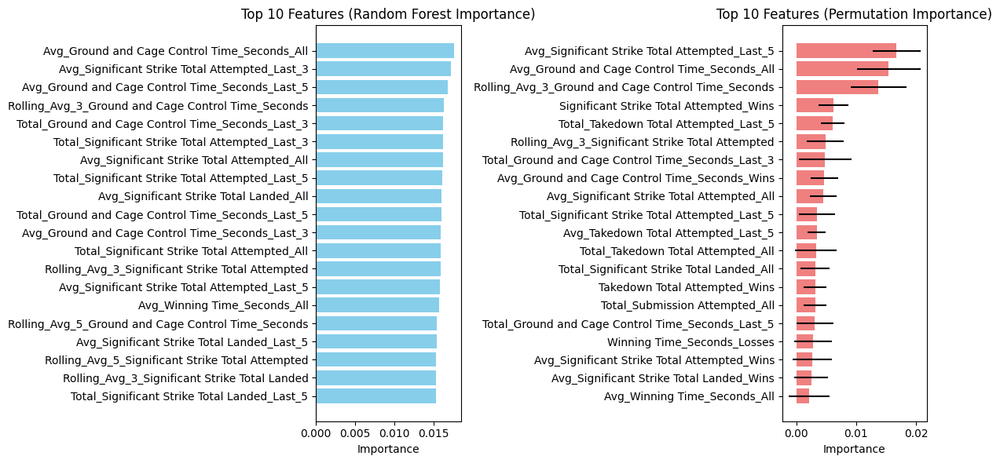

In [ ]:
result_df = pd.read_csv('/content/result_df_f.csv')
importance_results = calculate_feature_importance(result_df, feature_columns)


In [ ]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.inspection import permutation_importance
import matplotlib.pyplot as plt

def calculate_feature_importance(df, exclude_columns=None, fighter_first_col='Fighter First Name',
                                fighter_last_col='Fighter Last Name', winner_first_col='Winner First Name',
                                winner_last_col='Winner Last Name', random_state=42):

    df['Is_Winner'] = ((df[fighter_first_col] == df[winner_first_col]) &
                       (df[fighter_last_col] == df[winner_last_col])).astype(int)

    if exclude_columns is None:
        exclude_columns = [fighter_first_col, fighter_last_col, winner_first_col, winner_last_col, 'Fight ID', 'Is_Winner']

    feature_columns = [col for col in df.columns if col not in exclude_columns]

    numerical_cols = df[feature_columns].select_dtypes(include=[np.number]).columns.tolist()
    categorical_cols = df[feature_columns].select_dtypes(exclude=[np.number]).columns.tolist()

    X = df[feature_columns].copy()
    if categorical_cols:
        X_encoded = pd.get_dummies(X[categorical_cols], drop_first=True)
        X = pd.concat([X[numerical_cols], X_encoded], axis=1)

    feature_columns = X.columns.tolist()

    X = X.fillna(0)
    X = X.replace([np.inf, -np.inf], 0)

    y = df['Is_Winner']

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=random_state, stratify=y)

    rf_model = RandomForestClassifier(n_estimators=100, random_state=random_state, n_jobs=-1)
    rf_model.fit(X_train, y_train)

    # Step 8: Calculate Random Forest Feature Importance
    rf_importances = pd.DataFrame({
        'Feature': feature_columns,
        'Importance': rf_model.feature_importances_
    }).sort_values(by='Importance', ascending=False)

    # Step 9: Calculate Permutation Importance on the test set
    perm_importance = permutation_importance(
        rf_model, X_test, y_test, n_repeats=10, random_state=random_state, n_jobs=-1
    )
    perm_importances = pd.DataFrame({
        'Feature': feature_columns,
        'Importance': perm_importance.importances_mean,
        'Std': perm_importance.importances_std
    }).sort_values(by='Importance', ascending=False)

    # Step 10: Print the top 20 features for both methods
    print("\nTop 20 Features by Random Forest Importance:")
    print(rf_importances.head(20))

    print("\nTop 20 Features by Permutation Importance:")
    print(perm_importances.head(20))

    # Step 11: Plot the top 20 features for both methods
    plt.figure(figsize=(12, 8))

    # Random Forest Importance
    plt.subplot(1, 2, 1)
    top_rf = rf_importances.head(20)
    plt.barh(top_rf['Feature'], top_rf['Importance'], color='skyblue')
    plt.title('Top 20 Features (Random Forest Importance)')
    plt.xlabel('Importance')
    plt.gca().invert_yaxis()

    # Permutation Importance
    plt.subplot(1, 2, 2)
    top_perm = perm_importances.head(20)
    plt.barh(top_perm['Feature'], top_perm['Importance'], xerr=top_perm['Std'], color='lightcoral')
    plt.title('Top 20 Features (Permutation Importance)')
    plt.xlabel('Importance')
    plt.gca().invert_yaxis()

    plt.tight_layout()
    plt.show()

    # Step 12: Evaluate model performance
    y_pred = rf_model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    print(f"Random Forest Test Accuracy: {accuracy:.4f}")

    return {
        'Random Forest Importances': rf_importances,
        'Permutation Importances': perm_importances,
        'Model': rf_model,
        'Feature Columns': feature_columns
    }

# Example usage:
# Assuming 'result_df' is the DataFrame with all columns (original + generated stats)
exclude_columns = ['Fight ID', 'Fighter First Name', 'Fighter Last Name', 'Winner First Name', 'Winner Last Name']
importance_results = calculate_feature_importance(result_df, exclude_columns=exclude_columns)

KeyboardInterrupt: 

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

def perform_eda_winner_vs_features(df, feature_columns, fighter_first_col='Fighter First Name',
                                   fighter_last_col='Fighter Last Name', winner_first_col='Winner First Name',
                                   winner_last_col='Winner Last Name', batch_size=5):
    df['Is_Winner'] = ((df[fighter_first_col] == df[winner_first_col]) &
                       (df[fighter_last_col] == df[winner_last_col])).astype(int)

    df[feature_columns] = df[feature_columns].fillna(0)
    df[feature_columns] = df[feature_columns].replace([np.inf, -np.inf], 0)

    summary_stats = {}
    for col in feature_columns:
        stats = df.groupby('Is_Winner')[col].agg(['mean', 'median', 'std', 'min', 'max']).reset_index()
        summary_stats[col] = stats

    #Pearson correlation with Is_Winner
    correlations = df[feature_columns].corrwith(df['Is_Winner']).sort_values(ascending=False)
    correlations_df = pd.DataFrame({'Feature': correlations.index, 'Correlation': correlations.values})

    # box plots in batches and display inline
    num_features = len(feature_columns)
    num_plots = (num_features + batch_size - 1) // batch_size
    for i in range(num_plots):
        start_idx = i * batch_size
        end_idx = min((i + 1) * batch_size, num_features)
        batch_cols = feature_columns[start_idx:end_idx]

        #figure with subplots
        fig, axes = plt.subplots(nrows=len(batch_cols), ncols=1, figsize=(10, 5 * len(batch_cols)))
        if len(batch_cols) == 1:
            axes = [axes]

        for j, col in enumerate(batch_cols):
            sns.boxplot(x='Is_Winner', y=col, data=df, ax=axes[j])
            axes[j].set_title(f'Distribution of {col} by Is_Winner')
            axes[j].set_xlabel('Is_Winner (0 = Loss, 1 = Win)')
            axes[j].set_ylabel(col)

        plt.tight_layout()
        plt.show()

    # summary statistics and correlations
    print("\nSummary Statistics for Top 5 Features by Correlation:")
    top_5_features = correlations_df['Feature'].head(5).tolist()
    for col in top_5_features:
        print(f"\nFeature: {col}")
        print(summary_stats[col])

    print("\nTop 20 Features by Correlation with Is_Winner:")
    print(correlations_df.head(20))

    return {
        'Summary Statistics': summary_stats,
        'Correlations': correlations_df
    }

# Example usage in Colab:
# Assuming 'result_df' is the DataFrame with the generated stats columns
feature_columns = [
    # Significant Strike Total Attempted stats
    'Significant Strike Total Attempted_Wins',
    'Avg_Significant Strike Total Attempted_Wins',
    'Significant Strike Total Attempted_Losses',
    'Avg_Significant Strike Total Attempted_Losses',
    'Rolling_Avg_3_Significant Strike Total Attempted',
    'Rolling_Avg_5_Significant Strike Total Attempted',
    'Total_Significant Strike Total Attempted_Last_5',
    'Avg_Significant Strike Total Attempted_Last_5',
    'Total_Significant Strike Total Attempted_Last_3',
    'Avg_Significant Strike Total Attempted_Last_3',
    'Total_Significant Strike Total Attempted_All',
    'Avg_Significant Strike Total Attempted_All',
    # Significant Strike Total Landed stats
    'Significant Strike Total Landed_Wins',
    'Avg_Significant Strike Total Landed_Wins',
    'Significant Strike Total Landed_Losses',
    'Avg_Significant Strike Total Landed_Losses',
    'Rolling_Avg_3_Significant Strike Total Landed',
    'Rolling_Avg_5_Significant Strike Total Landed',
    'Total_Significant Strike Total Landed_Last_5',
    'Avg_Significant Strike Total Landed_Last_5',
    'Total_Significant Strike Total Landed_Last_3',
    'Avg_Significant Strike Total Landed_Last_3',
    'Total_Significant Strike Total Landed_All',
    'Avg_Significant Strike Total Landed_All',
    # Takedown Total Attempted stats
    'Takedown Total Attempted_Wins',
    'Avg_Takedown Total Attempted_Wins',
    'Takedown Total Attempted_Losses',
    'Avg_Takedown Total Attempted_Losses',
    'Rolling_Avg_3_Takedown Total Attempted',
    'Rolling_Avg_5_Takedown Total Attempted',
    'Total_Takedown Total Attempted_Last_5',
    'Avg_Takedown Total Attempted_Last_5',
    'Total_Takedown Total Attempted_Last_3',
    'Avg_Takedown Total Attempted_Last_3',
    'Total_Takedown Total Attempted_All',
    'Avg_Takedown Total Attempted_All',
    # Takedown Total Landed stats
    'Takedown Total Landed_Wins',
    'Avg_Takedown Total Landed_Wins',
    'Takedown Total Landed_Losses',
    'Avg_Takedown Total Landed_Losses',
    'Rolling_Avg_3_Takedown Total Landed',
    'Rolling_Avg_5_Takedown Total Landed',
    'Total_Takedown Total Landed_Last_5',
    'Avg_Takedown Total Landed_Last_5',
    'Total_Takedown Total Landed_Last_3',
    'Avg_Takedown Total Landed_Last_3',
    'Total_Takedown Total Landed_All',
    'Avg_Takedown Total Landed_All',
    # Submission Attempted stats
    'Submission Attempted_Wins',
    'Avg_Submission Attempted_Wins',
    'Submission Attempted_Losses',
    'Avg_Submission Attempted_Losses',
    'Rolling_Avg_3_Submission Attempted',
    'Rolling_Avg_5_Submission Attempted',
    'Total_Submission Attempted_Last_5',
    'Avg_Submission Attempted_Last_5',
    'Total_Submission Attempted_Last_3',
    'Avg_Submission Attempted_Last_3',
    'Total_Submission Attempted_All',
    'Avg_Submission Attempted_All',
    # Ground and Cage Control Time stats
    'Ground and Cage Control Time_Seconds_Wins',
    'Avg_Ground and Cage Control Time_Seconds_Wins',
    'Ground and Cage Control Time_Seconds_Losses',
    'Avg_Ground and Cage Control Time_Seconds_Losses',
    'Rolling_Avg_3_Ground and Cage Control Time_Seconds',
    'Rolling_Avg_5_Ground and Cage Control Time_Seconds',
    'Total_Ground and Cage Control Time_Seconds_Last_5',
    'Avg_Ground and Cage Control Time_Seconds_Last_5',
    'Total_Ground and Cage Control Time_Seconds_Last_3',
    'Avg_Ground and Cage Control Time_Seconds_Last_3',
    'Total_Ground and Cage Control Time_Seconds_All',
    'Avg_Ground and Cage Control Time_Seconds_All',
    # Winning Round stats
    'Avg_Winning Round_Wins',
    'Avg_Winning Round_Losses',
    'Rolling_Avg_3_Winning Round',
    'Rolling_Avg_5_Winning Round',
    'Avg_Winning Round_Last_5',
    'Avg_Winning Round_Last_3',
    'Avg_Winning Round_All',
    # Winning Time stats
    'Winning Time_Seconds_Wins',
    'Avg_Winning Time_Seconds_Wins',
    'Winning Time_Seconds_Losses',
    'Avg_Winning Time_Seconds_Losses',
    'Rolling_Avg_3_Winning Time_Seconds',
    'Rolling_Avg_5_Winning Time_Seconds',
    'Total_Winning Time_Seconds_Last_5',
    'Avg_Winning Time_Seconds_Last_5',
    'Total_Winning Time_Seconds_Last_3',
    'Avg_Winning Time_Seconds_Last_3',
    'Total_Winning Time_Seconds_All',
    'Avg_Winning Time_Seconds_All'
]


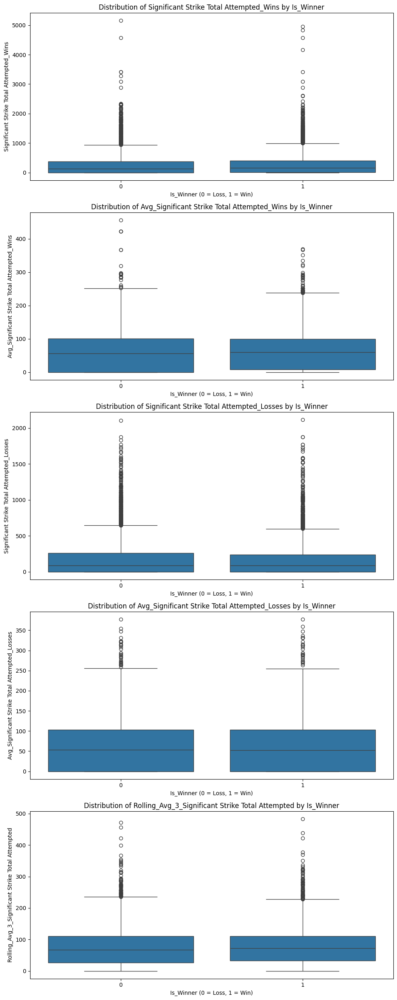

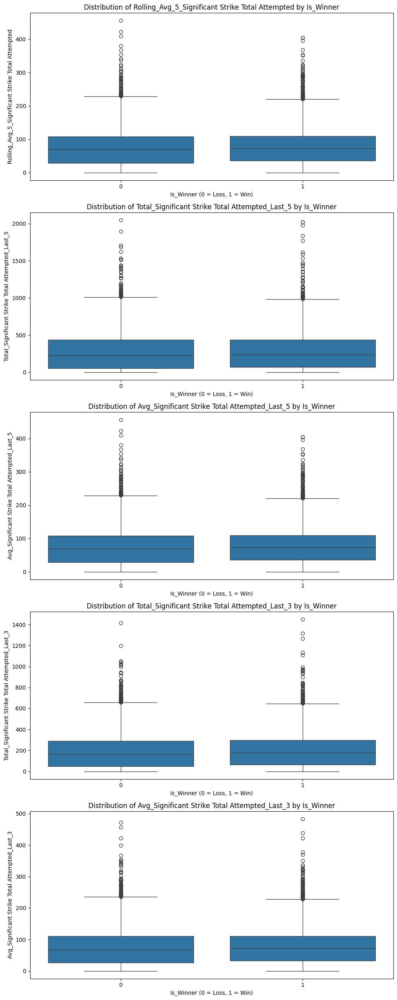

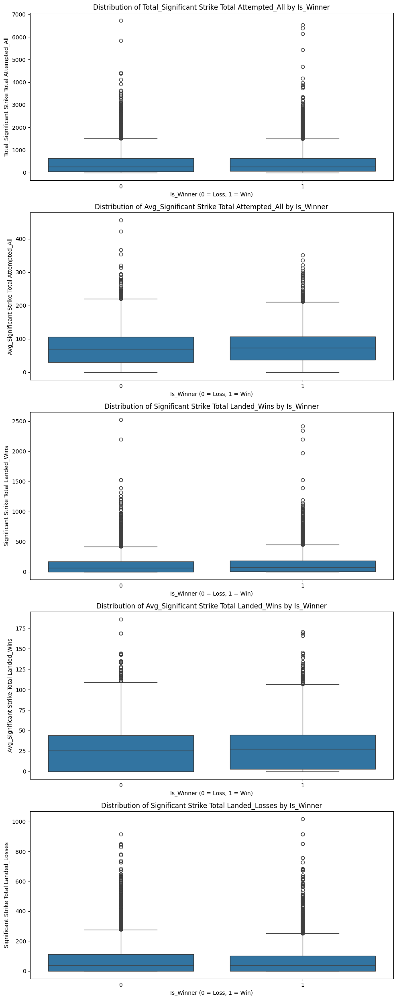

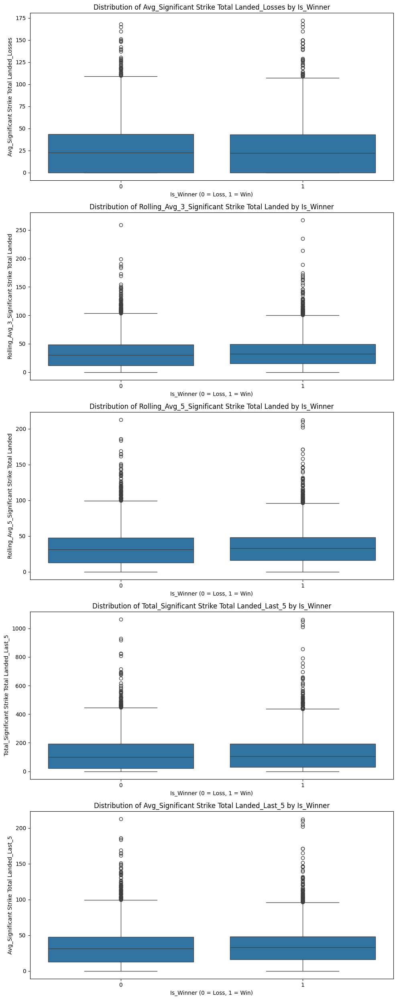

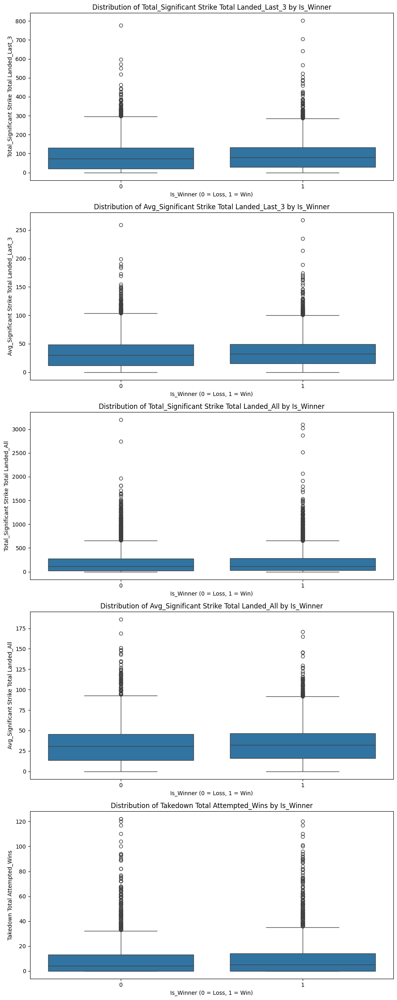

...

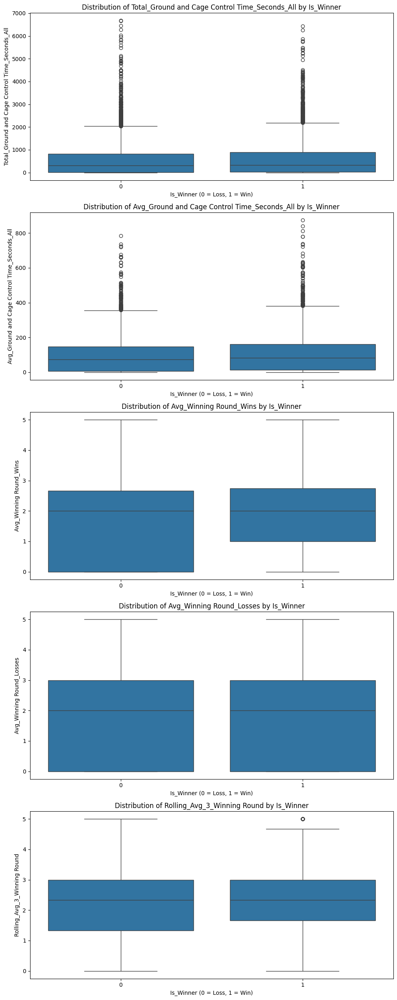

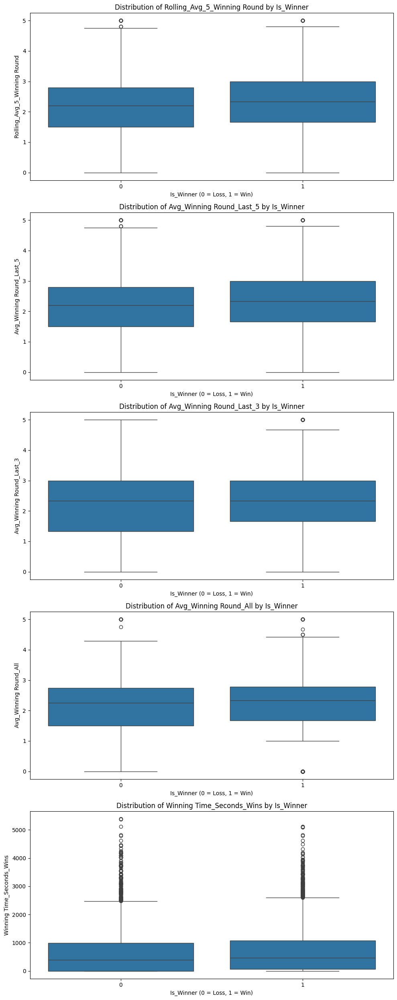

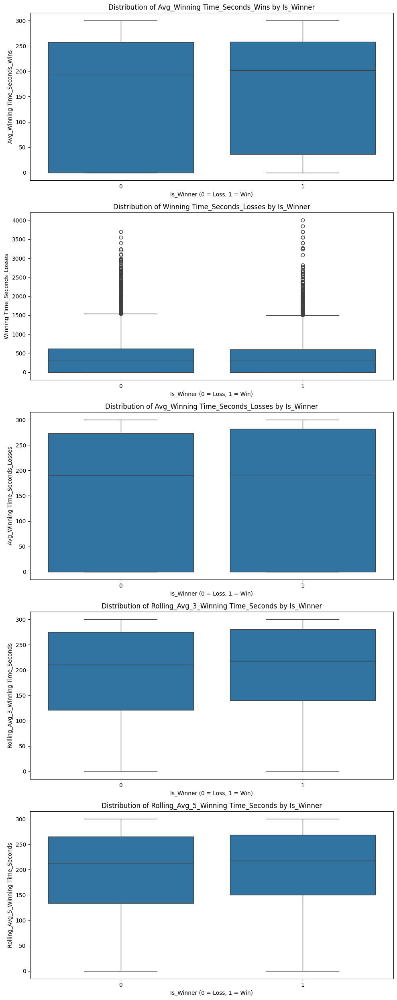

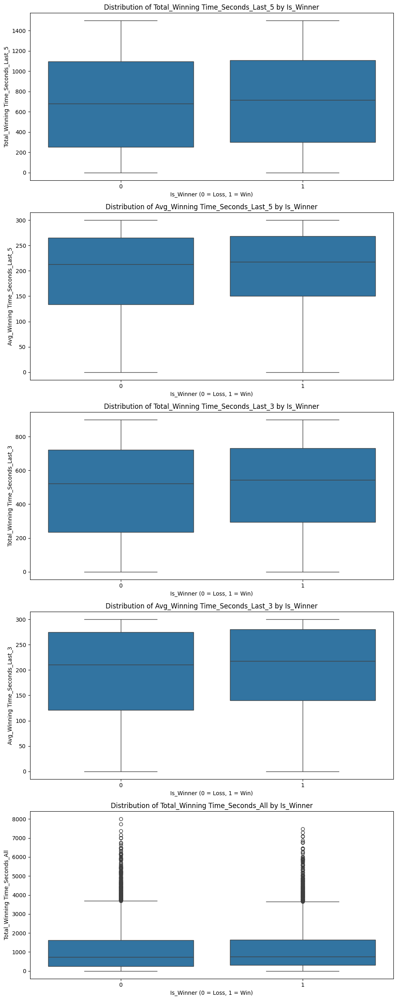

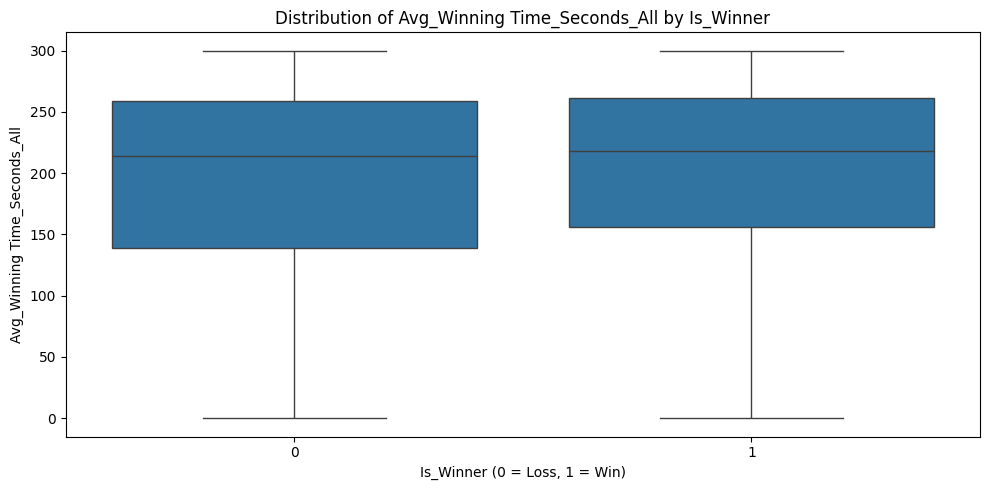


Summary Statistics for Top 5 Features by Correlation:

Feature: Rolling_Avg_5_Takedown Total Attempted
   Is_Winner      mean  median       std  min   max
0          0  2.263158    1.75  2.390383  0.0  23.0
1          1  2.584980    2.00  2.635155  0.0  22.0

Feature: Avg_Takedown Total Attempted_Last_5
   Is_Winner      mean  median       std  min   max
0          0  2.263158    1.75  2.390383  0.0  23.0
1          1  2.584980    2.00  2.635155  0.0  22.0

Feature: Rolling_Avg_5_Takedown Total Landed
   Is_Winner      mean  median       std  min   max
0          0  0.813280     0.5  0.994497  0.0  11.0
1          1  0.944842     0.6  1.134827  0.0  11.0

Feature: Avg_Takedown Total Landed_Last_5
   Is_Winner      mean  median       std  min   max
0          0  0.813280     0.5  0.994497  0.0  11.0
1          1  0.944842     0.6  1.134827  0.0  11.0

Feature: Rolling_Avg_3_Takedown Total Attempted
   Is_Winner      mean  median       std  min   max
0          0  2.254574     1.5  2.53

In [ ]:
eda_results = perform_eda_winner_vs_features(result_df, feature_columns)


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

def perform_eda_winner_vs_features(df, feature_columns, fighter_first_col='Fighter First Name',
                                   fighter_last_col='Fighter Last Name', winner_first_col='Winner First Name',
                                   winner_last_col='Winner Last Name', batch_size=5):
    df['Is_Winner'] = ((df[fighter_first_col] == df[winner_first_col]) &
                       (df[fighter_last_col] == df[winner_last_col])).astype(int)

    df[feature_columns] = df[feature_columns].fillna(0)
    df[feature_columns] = df[feature_columns].replace([np.inf, -np.inf], 0)

    summary_stats = {}
    for col in feature_columns:
        stats = df.groupby('Is_Winner')[col].agg(['mean', 'median', 'std', 'min', 'max']).reset_index()
        summary_stats[col] = stats

    correlations = df[feature_columns].corrwith(df['Is_Winner']).sort_values(ascending=False)
    correlations_df = pd.DataFrame({'Feature': correlations.index, 'Correlation': correlations.values})

    num_features = len(feature_columns)
    num_plots = (num_features + batch_size - 1) // batch_size

    for i in range(num_plots):
        start_idx = i * batch_size
        end_idx = min((i + 1) * batch_size, num_features)
        batch_cols = feature_columns[start_idx:end_idx]

        fig, axes = plt.subplots(nrows=len(batch_cols), ncols=1, figsize=(10, 5 * len(batch_cols)))
        if len(batch_cols) == 1:
            axes = [axes]

        for j, col in enumerate(batch_cols):
            sns.violinplot(x='Is_Winner', y=col, data=df, ax=axes[j])
            axes[j].set_title(f'Distribution of {col} by Is_Winner')
            axes[j].set_xlabel('Is_Winner (0 = Loss, 1 = Win)')
            axes[j].set_ylabel(col)

        plt.tight_layout()
        plt.show()

    print("\nSummary Statistics for Top 5 Features by Correlation:")
    top_5_features = correlations_df['Feature'].head(5).tolist()
    for col in top_5_features:
        print(f"\nFeature: {col}")
        print(summary_stats[col])

    print("\nTop 20 Features by Correlation with Is_Winner:")
    print(correlations_df.head(20))

    return {
        'Summary Statistics': summary_stats,
        'Correlations': correlations_df
    }

feature_columns = [
    'Significant Strike Total Attempted_Wins',
    'Avg_Significant Strike Total Attempted_Wins',
    'Significant Strike Total Attempted_Losses',
    'Avg_Significant Strike Total Attempted_Losses',
    'Rolling_Avg_3_Significant Strike Total Attempted',
    'Rolling_Avg_5_Significant Strike Total Attempted',
    'Total_Significant Strike Total Attempted_Last_5',
    'Avg_Significant Strike Total Attempted_Last_5',
    'Total_Significant Strike Total Attempted_Last_3',
    'Avg_Significant Strike Total Attempted_Last_3',
    'Total_Significant Strike Total Attempted_All',
    'Avg_Significant Strike Total Attempted_All',
    'Significant Strike Total Landed_Wins',
    'Avg_Significant Strike Total Landed_Wins',
    'Significant Strike Total Landed_Losses',
    'Avg_Significant Strike Total Landed_Losses',
    'Rolling_Avg_3_Significant Strike Total Landed',
    'Rolling_Avg_5_Significant Strike Total Landed',
    'Total_Significant Strike Total Landed_Last_5',
    'Avg_Significant Strike Total Landed_Last_5',
    'Total_Significant Strike Total Landed_Last_3',
    'Avg_Significant Strike Total Landed_Last_3',
    'Total_Significant Strike Total Landed_All',
    'Avg_Significant Strike Total Landed_All',
    'Takedown Total Attempted_Wins',
    'Avg_Takedown Total Attempted_Wins',
    'Takedown Total Attempted_Losses',
    'Avg_Takedown Total Attempted_Losses',
    'Rolling_Avg_3_Takedown Total Attempted',
    'Rolling_Avg_5_Takedown Total Attempted',
    'Total_Takedown Total Attempted_Last_5',
    'Avg_Takedown Total Attempted_Last_5',
    'Total_Takedown Total Attempted_Last_3',
    'Avg_Takedown Total Attempted_Last_3',
    'Total_Takedown Total Attempted_All',
    'Avg_Takedown Total Attempted_All',
    'Takedown Total Landed_Wins',
    'Avg_Takedown Total Landed_Wins',
    'Takedown Total Landed_Losses',
    'Avg_Takedown Total Landed_Losses',
    'Rolling_Avg_3_Takedown Total Landed',
    'Rolling_Avg_5_Takedown Total Landed',
    'Total_Takedown Total Landed_Last_5',
    'Avg_Takedown Total Landed_Last_5',
    'Total_Takedown Total Landed_Last_3',
    'Avg_Takedown Total Landed_Last_3',
    'Total_Takedown Total Landed_All',
    'Avg_Takedown Total Landed_All',
    'Submission Attempted_Wins',
    'Avg_Submission Attempted_Wins',
    'Submission Attempted_Losses',
    'Avg_Submission Attempted_Losses',
    'Rolling_Avg_3_Submission Attempted',
    'Rolling_Avg_5_Submission Attempted',
    'Total_Submission Attempted_Last_5',
    'Avg_Submission Attempted_Last_5',
    'Total_Submission Attempted_Last_3',
    'Avg_Submission Attempted_Last_3',
    'Total_Submission Attempted_All',
    'Avg_Submission Attempted_All',
    'Ground and Cage Control Time_Seconds_Wins',
    'Avg_Ground and Cage Control Time_Seconds_Wins',
    'Ground and Cage Control Time_Seconds_Losses',
    'Avg_Ground and Cage Control Time_Seconds_Losses',
    'Rolling_Avg_3_Ground and Cage Control Time_Seconds',
    'Rolling_Avg_5_Ground and Cage Control Time_Seconds',
    'Total_Ground and Cage Control Time_Seconds_Last_5',
    'Avg_Ground and Cage Control Time_Seconds_Last_5',
    'Total_Ground and Cage Control Time_Seconds_Last_3',
    'Avg_Ground and Cage Control Time_Seconds_Last_3',
    'Total_Ground and Cage Control Time_Seconds_All',
    'Avg_Ground and Cage Control Time_Seconds_All',
    'Avg_Winning Round_Wins',
    'Avg_Winning Round_Losses',
    'Rolling_Avg_3_Winning Round',
    'Rolling_Avg_5_Winning Round',
    'Avg_Winning Round_Last_5',
    'Avg_Winning Round_Last_3',
    'Avg_Winning Round_All',
    'Winning Time_Seconds_Wins',
    'Avg_Winning Time_Seconds_Wins',
    'Winning Time_Seconds_Losses',
    'Avg_Winning Time_Seconds_Losses',
    'Rolling_Avg_3_Winning Time_Seconds',
    'Rolling_Avg_5_Winning Time_Seconds',
    'Total_Winning Time_Seconds_Last_5',
    'Avg_Winning Time_Seconds_Last_5',
    'Total_Winning Time_Seconds_Last_3',
    'Avg_Winning Time_Seconds_Last_3',
    'Total_Winning Time_Seconds_All',
    'Avg_Winning Time_Seconds_All'
]

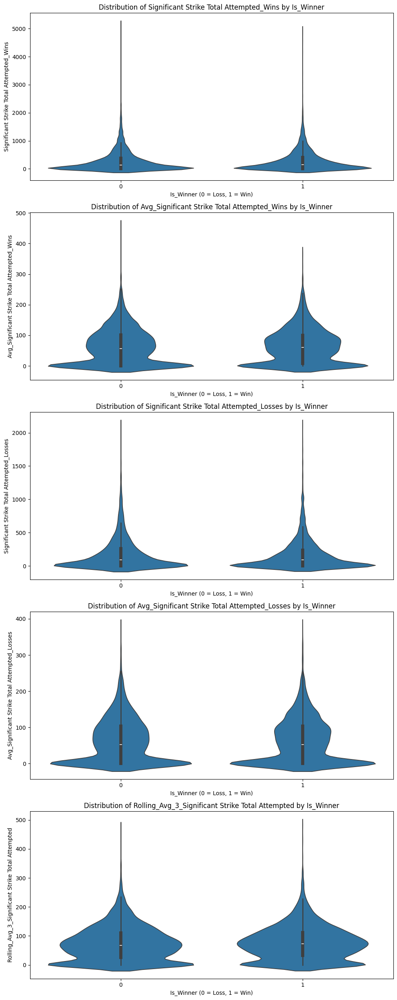

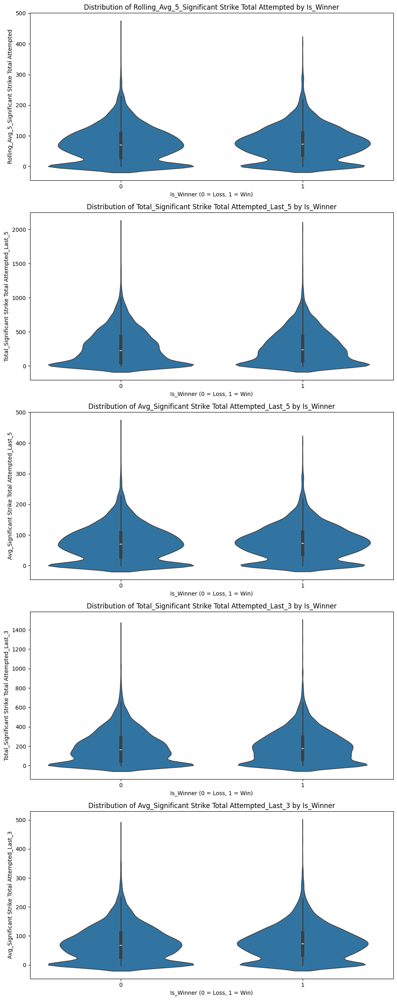

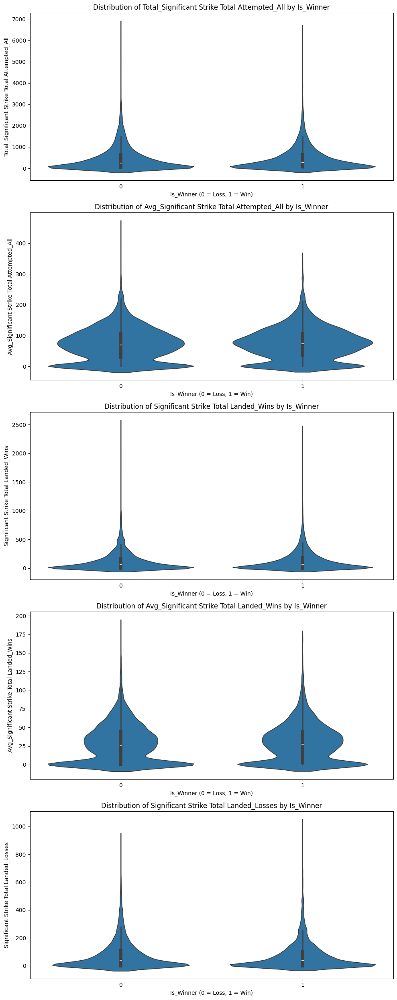

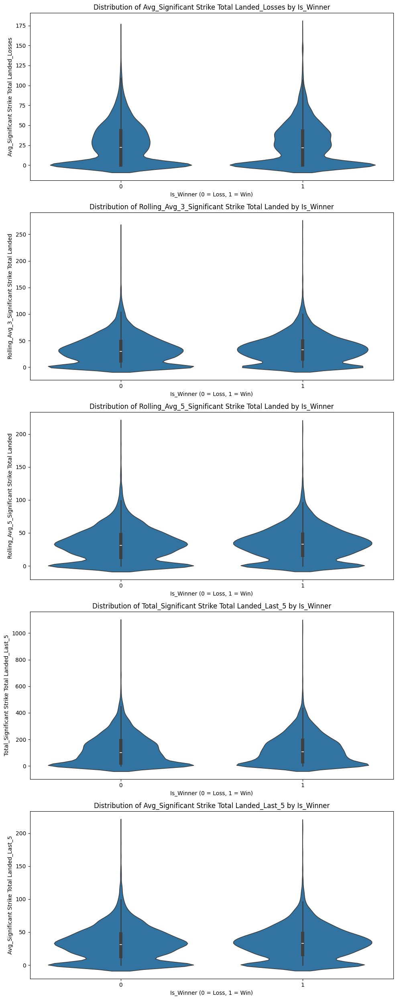

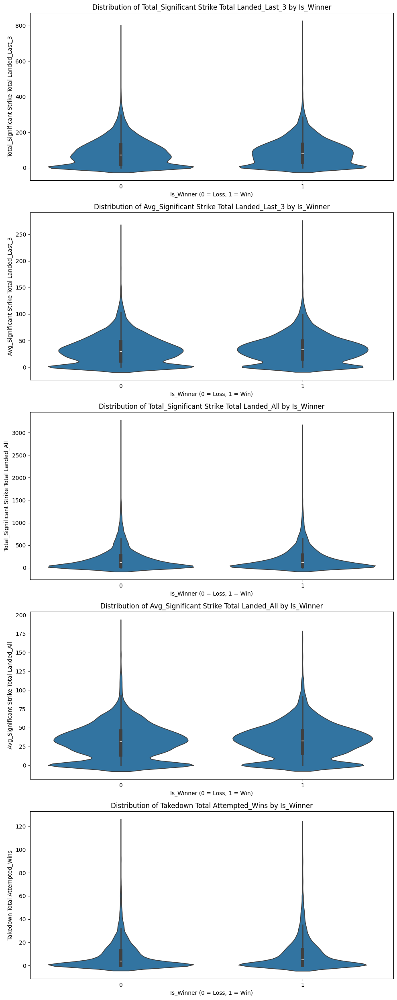

...

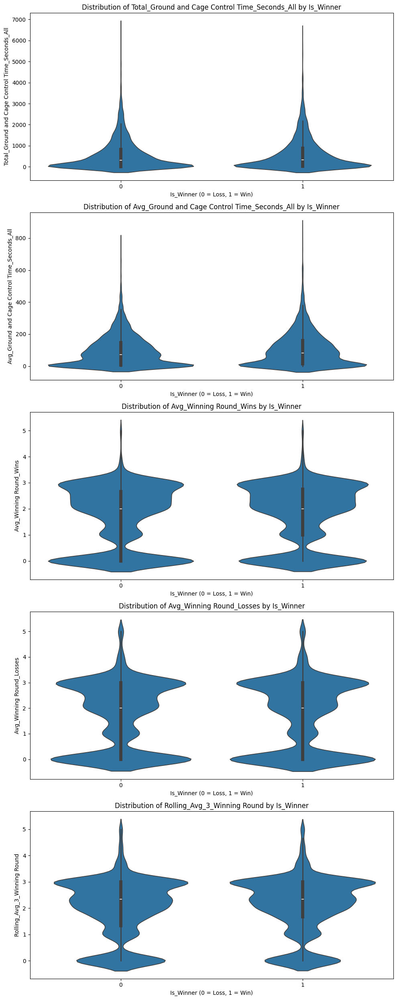

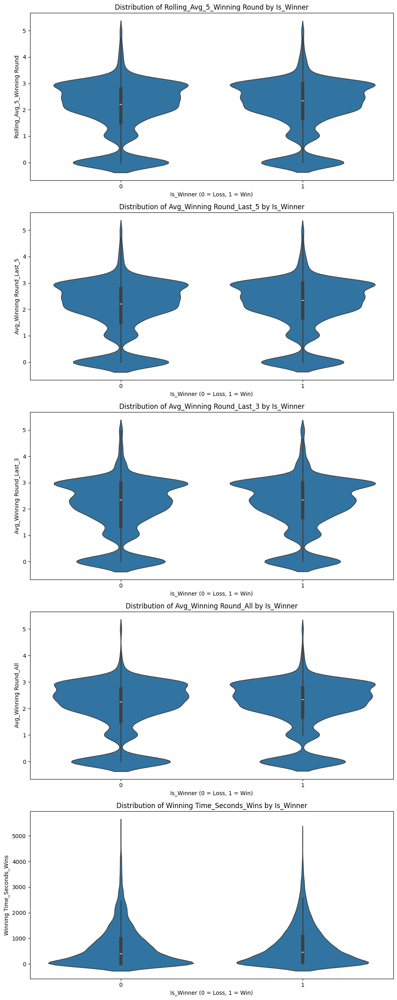

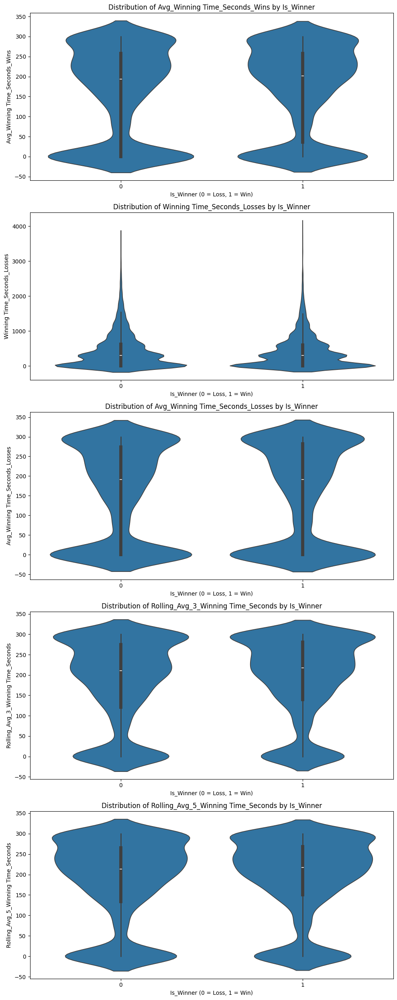

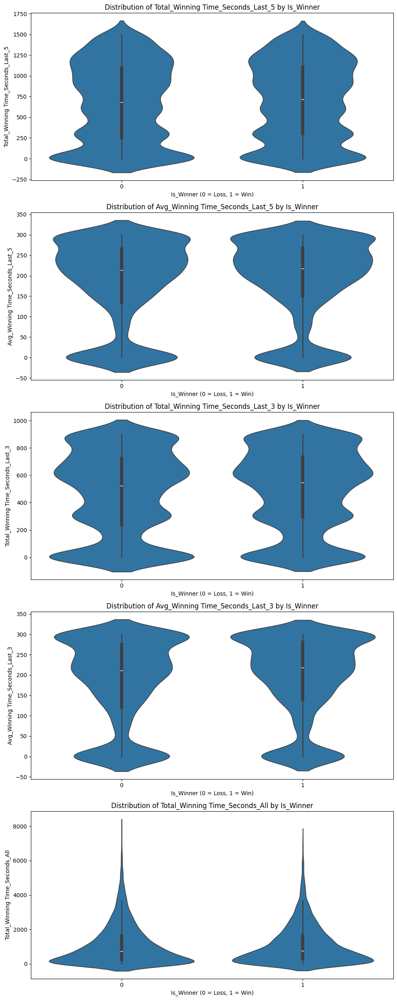

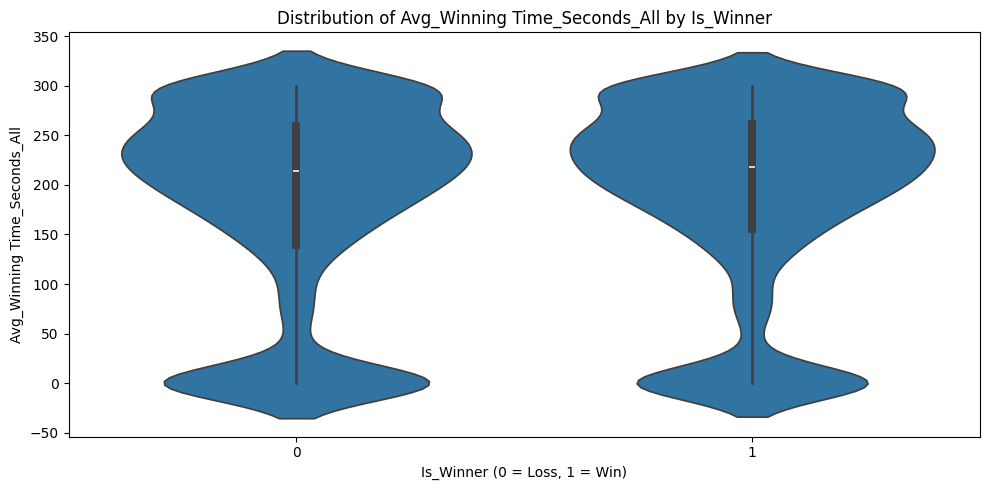


Summary Statistics for Top 5 Features by Correlation:

Feature: Rolling_Avg_5_Takedown Total Attempted
   Is_Winner      mean  median       std  min   max
0          0  2.263158    1.75  2.390383  0.0  23.0
1          1  2.584980    2.00  2.635155  0.0  22.0

Feature: Avg_Takedown Total Attempted_Last_5
   Is_Winner      mean  median       std  min   max
0          0  2.263158    1.75  2.390383  0.0  23.0
1          1  2.584980    2.00  2.635155  0.0  22.0

Feature: Rolling_Avg_5_Takedown Total Landed
   Is_Winner      mean  median       std  min   max
0          0  0.813280     0.5  0.994497  0.0  11.0
1          1  0.944842     0.6  1.134827  0.0  11.0

Feature: Avg_Takedown Total Landed_Last_5
   Is_Winner      mean  median       std  min   max
0          0  0.813280     0.5  0.994497  0.0  11.0
1          1  0.944842     0.6  1.134827  0.0  11.0

Feature: Rolling_Avg_3_Takedown Total Attempted
   Is_Winner      mean  median       std  min   max
0          0  2.254574     1.5  2.53

In [ ]:
eda_results = perform_eda_winner_vs_features(result_df, feature_columns)


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import spearmanr
from itertools import combinations

%matplotlib inline

def eda_winner_vs_features_alternative_plots(df, feature_columns, fighter_first_col='Fighter First Name',
                                             fighter_last_col='Fighter Last Name', winner_first_col='Winner First Name',
                                             winner_last_col='Winner Last Name', batch_size=5):
    # Validate and create Is_Winner column
    df['Is_Winner'] = ((df[fighter_first_col] == df[winner_first_col]) &
                       (df[fighter_last_col] == df[winner_last_col])).astype(int)

    # Check for missing winner names or potential draws
    missing_winner = df[[winner_first_col, winner_last_col]].isna().any(axis=1)
    if missing_winner.sum() > 0:
        print(f"Warning: {missing_winner.sum()} rows have missing winner names. These rows will be treated as losses (Is_Winner = 0).")

    potential_draws = df[~((df[fighter_first_col] == df[winner_first_col]) &
                           (df[fighter_last_col] == df[winner_last_col])) &
                         ~((df[fighter_first_col] != df[winner_first_col]) |
                           (df[fighter_last_col] != df[winner_last_col]))]
    if len(potential_draws) > 0:
        print(f"Warning: {len(potential_draws)} rows may represent draws or errors. Review these rows:")
        print(potential_draws[[fighter_first_col, fighter_last_col, winner_first_col, winner_last_col]])

    # Handle missing values and infinities
    df[feature_columns] = df[feature_columns].fillna(0)
    df[feature_columns] = df[feature_columns].replace([np.inf, -np.inf], 0)

    # Check for outliers using IQR
    outlier_counts = {}
    for col in feature_columns:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        outliers = df[(df[col] < (Q1 - 1.5 * IQR)) | (df[col] > (Q3 + 1.5 * IQR))][col]
        outlier_counts[col] = len(outliers)
    print("\nNumber of Outliers per Feature (Top 5):")
    outlier_counts = pd.Series(outlier_counts).sort_values(ascending=False)
    print(outlier_counts.head(5))

    # Compute summary statistics
    summary_stats = {}
    for col in feature_columns:
        stats = df.groupby('Is_Winner')[col].agg(['mean', 'median', 'std', 'min', 'max']).reset_index()
        summary_stats[col] = stats

    # Compute Spearman correlation with Is_Winner
    correlations = {}
    for col in feature_columns:
        corr, _ = spearmanr(df[col], df['Is_Winner'])
        correlations[col] = corr
    correlations = pd.Series(correlations).sort_values(ascending=False)
    correlations_df = pd.DataFrame({'Feature': correlations.index, 'Spearman Correlation': correlations.values})

    # KDE plots in batches
    num_features = len(feature_columns)
    num_plots = (num_features + batch_size - 1) // batch_size
    for i in range(num_plots):
        start_idx = i * batch_size
        end_idx = min((i + 1) * batch_size, num_features)
        batch_cols = feature_columns[start_idx:end_idx]

        fig, axes = plt.subplots(nrows=len(batch_cols), ncols=1, figsize=(10, 5 * len(batch_cols)))
        if len(batch_cols) == 1:
            axes = [axes]

        for j, col in enumerate(batch_cols):
            # Plot KDE for Is_Winner = 0 and Is_Winner = 1
            sns.kdeplot(data=df[df['Is_Winner'] == 0], x=col, label='Loss (0)', color='red', ax=axes[j])
            sns.kdeplot(data=df[df['Is_Winner'] == 1], x=col, label='Win (1)', color='green', ax=axes[j])
            axes[j].set_title(f'KDE Plot: {col} by Is_Winner')
            axes[j].set_xlabel(col)
            axes[j].set_ylabel('Density')
            axes[j].legend()

        plt.tight_layout()
        plt.show()

    # Hexbin plots for top 5 features
    top_5_features = correlations_df['Feature'].head(5).tolist()
    print("\nHexbin Plots for Top 5 Features by Spearman Correlation:")
    for col in top_5_features:
        plt.figure(figsize=(8, 6))
        plt.hexbin(x=df[col], y=df['Is_Winner'], gridsize=30, cmap='Blues', mincnt=1)
        plt.colorbar(label='Count')
        plt.title(f'Hexbin Plot: {col} vs Is_Winner')
        plt.xlabel(col)
        plt.ylabel('Is_W catálogoinner (0 = Loss, 1 = Win)')
        plt.show()

    # Pair plot for top 3 features and Is_Winner
    top_3_features = correlations_df['Feature'].head(3).tolist()
    pair_plot_cols = top_3_features + ['Is_Winner']
    print("\nPair Plot for Top 3 Features and Is_Winner:")
    sns.pairplot(df[pair_plot_cols], hue='Is_Winner', palette={0: 'red', 1: 'green'})
    plt.show()

    # Interaction analysis: Pairwise combinations of top 5 features
    print("\nInteraction Analysis for Top 5 Features:")
    interaction_results = []
    for col1, col2 in combinations(top_5_features, 2):
        interaction_term = df[col1] * df[col2]
        corr, _ = spearmanr(interaction_term, df['Is_Winner'])
        interaction_results.append({
            'Feature 1': col1,
            'Feature 2': col2,
            'Spearman Correlation (Interaction)': corr
        })
    interaction_df = pd.DataFrame(interaction_results).sort_values(by='Spearman Correlation (Interaction)', ascending=False)
    print(interaction_df)

    # Print summary statistics and correlations
    print("\nSummary Statistics for Top 5 Features by Spearman Correlation:")
    for col in top_5_features:
        print(f"\nFeature: {col}")
        print(summary_stats[col])

    print("\nTop 20 Features by Spearman Correlation with Is_Winner:")
    print(correlations_df.head(20))

    return {
        'Summary Statistics': summary_stats,
        'Correlations': correlations_df,
        'Interactions': interaction_df
    }

# Example usage in Colab:
feature_columns = [
    'Significant Strike Total Attempted_Wins',
    'Avg_Significant Strike Total Attempted_Wins',
    'Significant Strike Total Attempted_Losses',
    'Avg_Significant Strike Total Attempted_Losses',
    'Rolling_Avg_3_Significant Strike Total Attempted',
    'Rolling_Avg_5_Significant Strike Total Attempted',
    'Total_Significant Strike Total Attempted_Last_5',
    'Avg_Significant Strike Total Attempted_Last_5',
    'Total_Significant Strike Total Attempted_Last_3',
    'Avg_Significant Strike Total Attempted_Last_3',
    'Total_Significant Strike Total Attempted_All',
    'Avg_Significant Strike Total Attempted_All',
    'Significant Strike Total Landed_Wins',
    'Avg_Significant Strike Total Landed_Wins',
    'Significant Strike Total Landed_Losses',
    'Avg_Significant Strike Total Landed_Losses',
    'Rolling_Avg_3_Significant Strike Total Landed',
    'Rolling_Avg_5_Significant Strike Total Landed',
    'Total_Significant Strike Total Landed_Last_5',
    'Avg_Significant Strike Total Landed_Last_5',
    'Total_Significant Strike Total Landed_Last_3',
    'Avg_Significant Strike Total Landed_Last_3',
    'Total_Significant Strike Total Landed_All',
    'Avg_Significant Strike Total Landed_All',
    'Takedown Total Attempted_Wins',
    'Avg_Takedown Total Attempted_Wins',
    'Takedown Total Attempted_Losses',
    'Avg_Takedown Total Attempted_Losses',
    'Rolling_Avg_3_Takedown Total Attempted',
    'Rolling_Avg_5_Takedown Total Attempted',
    'Total_Takedown Total Attempted_Last_5',
    'Avg_Takedown Total Attempted_Last_5',
    'Total_Takedown Total Attempted_Last_3',
    'Avg_Takedown Total Attempted_Last_3',
    'Total_Takedown Total Attempted_All',
    'Avg_Takedown Total Attempted_All',
    'Takedown Total Landed_Wins',
    'Avg_Takedown Total Landed_Wins',
    'Takedown Total Landed_Losses',
    'Avg_Takedown Total Landed_Losses',
    'Rolling_Avg_3_Takedown Total Landed',
    'Rolling_Avg_5_Takedown Total Landed',
    'Total_Takedown Total Landed_Last_5',
    'Avg_Takedown Total Landed_Last_5',
    'Total_Takedown Total Landed_Last_3',
    'Avg_Takedown Total Landed_Last_3',
    'Total_Takedown Total Landed_All',
    'Avg_Takedown Total Landed_All',
    'Submission Attempted_Wins',
    'Avg_Submission Attempted_Wins',
    'Submission Attempted_Losses',
    'Avg_Submission Attempted_Losses',
    'Rolling_Avg_3_Submission Attempted',
    'Rolling_Avg_5_Submission Attempted',
    'Total_Submission Attempted_Last_5',
    'Avg_Submission Attempted_Last_5',
    'Total_Submission Attempted_Last_3',
    'Avg_Submission Attempted_Last_3',
    'Total_Submission Attempted_All',
    'Avg_Submission Attempted_All',
    'Ground and Cage Control Time_Seconds_Wins',
    'Avg_Ground and Cage Control Time_Seconds_Wins',
    'Ground and Cage Control Time_Seconds_Losses',
    'Avg_Ground and Cage Control Time_Seconds_Losses',
    'Rolling_Avg_3_Ground and Cage Control Time_Seconds',
    'Rolling_Avg_5_Ground and Cage Control Time_Seconds',
    'Total_Ground and Cage Control Time_Seconds_Last_5',
    'Avg_Ground and Cage Control Time_Seconds_Last_5',
    'Total_Ground and Cage Control Time_Seconds_Last_3',
    'Avg_Ground and Cage Control Time_Seconds_Last_3',
    'Total_Ground and Cage Control Time_Seconds_All',
    'Avg_Ground and Cage Control Time_Seconds_All',
    'Avg_Winning Round_Wins',
    'Avg_Winning Round_Losses',
    'Rolling_Avg_3_Winning Round',
    'Rolling_Avg_5_Winning Round',
    'Avg_Winning Round_Last_5',
    'Avg_Winning Round_Last_3',
    'Avg_Winning Round_All',
    'Winning Time_Seconds_Wins',
    'Avg_Winning Time_Seconds_Wins',
    'Winning Time_Seconds_Losses',
    'Avg_Winning Time_Seconds_Losses',
    'Rolling_Avg_3_Winning Time_Seconds',
    'Rolling_Avg_5_Winning Time_Seconds',
    'Total_Winning Time_Seconds_Last_5',
    'Avg_Winning Time_Seconds_Last_5',
    'Total_Winning Time_Seconds_Last_3',
    'Avg_Winning Time_Seconds_Last_3',
    'Total_Winning Time_Seconds_All',
    'Avg_Winning Time_Seconds_All'
]

# To run the EDA in Colab:

<ipython-input-17-fe53f537a3d0>:1: DtypeWarning: Columns (7,25,43,61,79,97,115) have mixed types. Specify dtype option on import or set low_memory=False.
  result_df = pd.read_csv('/content/result_df_f.csv')



Number of Outliers per Feature (Top 5):
Submission Attempted_Wins            2142
Avg_Submission Attempted_Losses      2107
Avg_Winning Round_All                2032
Total_Submission Attempted_Last_5    1751
Avg_Submission Attempted_Last_3      1496
dtype: int64


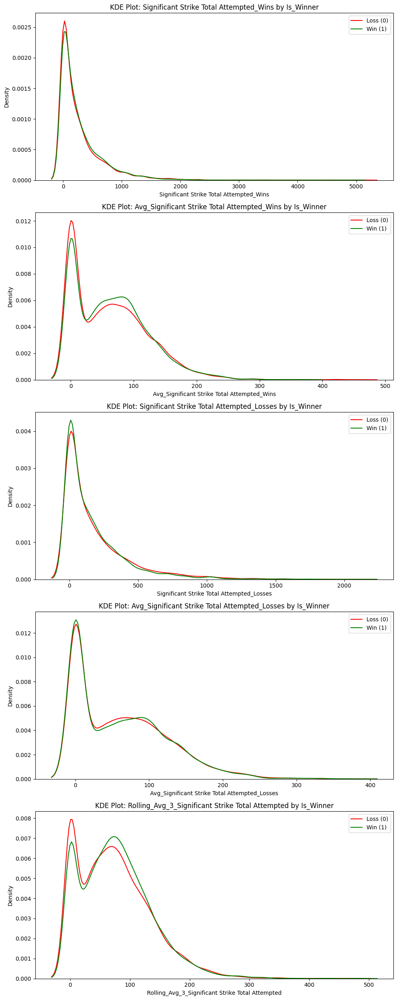

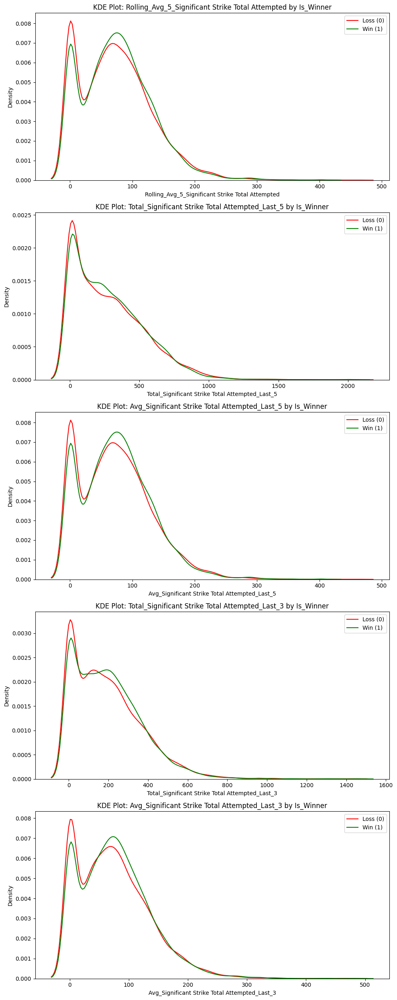

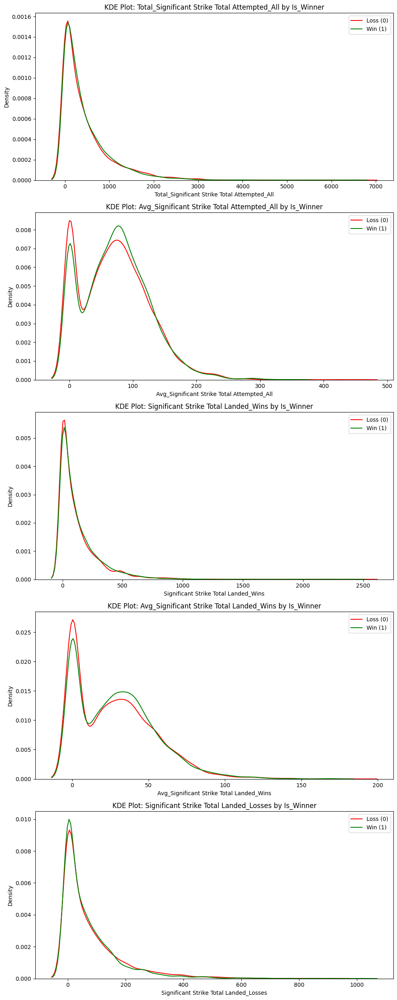

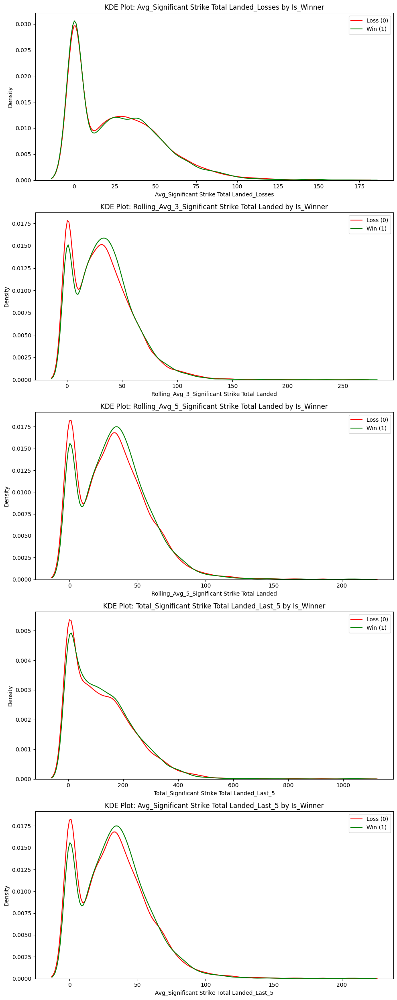

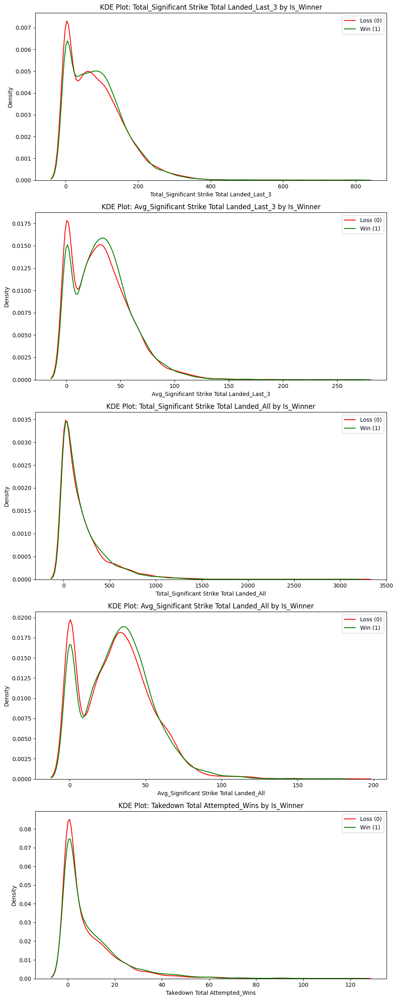

...

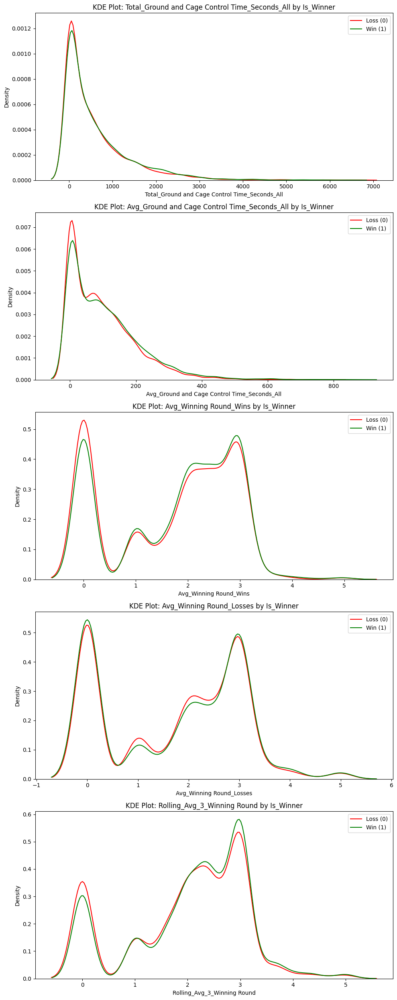

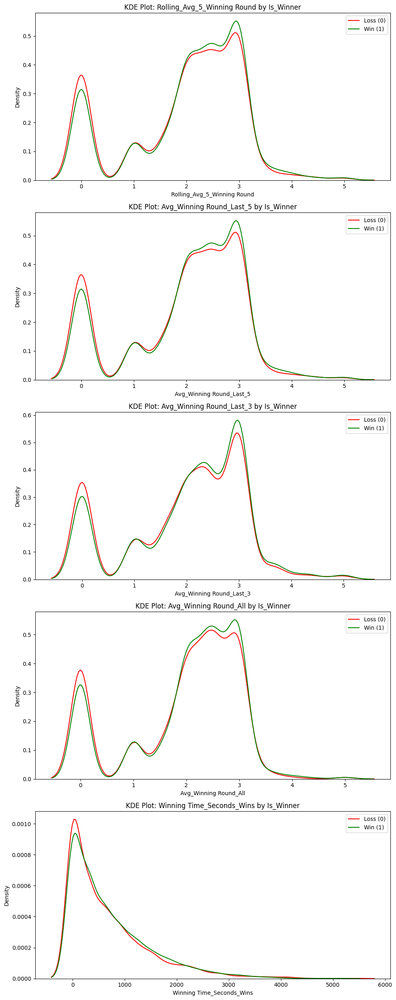

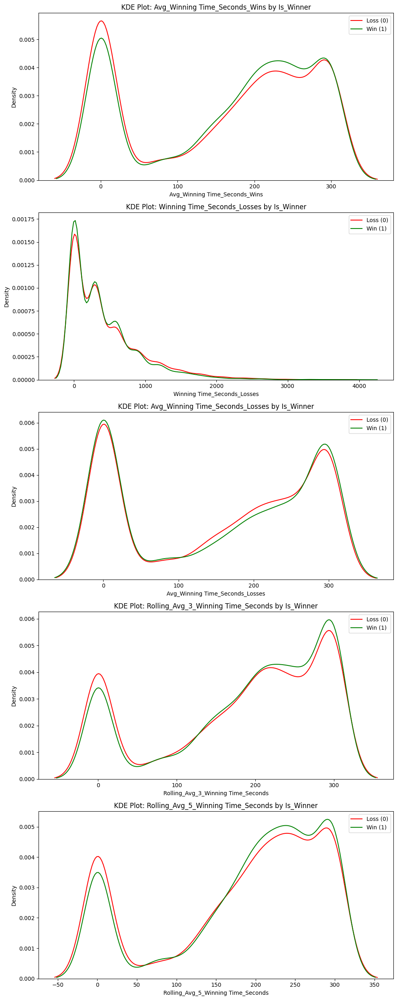

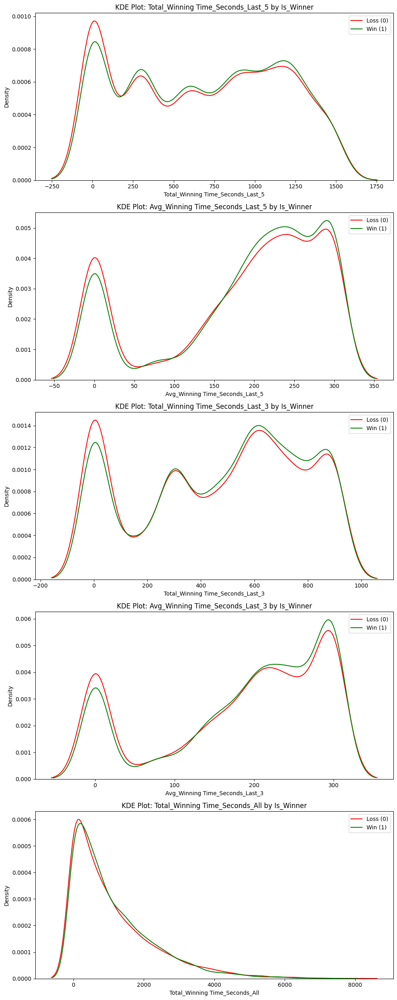

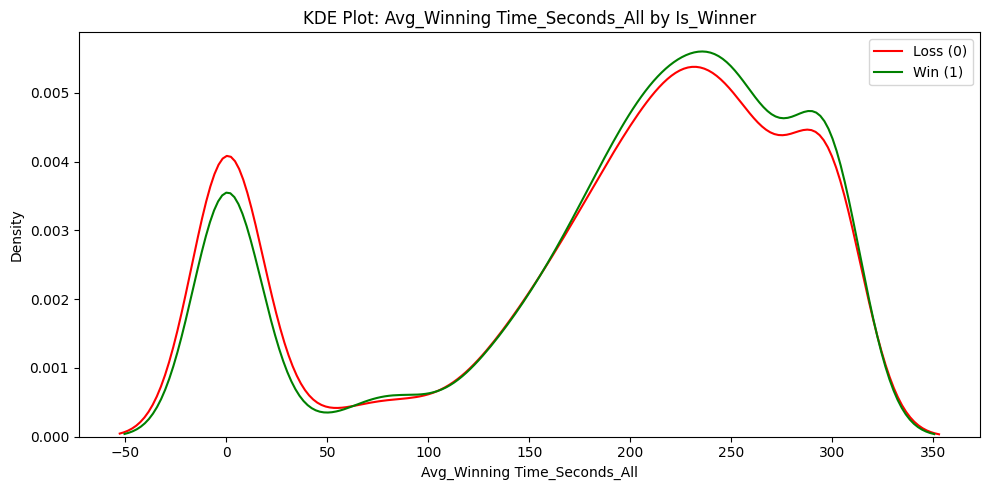


Hexbin Plots for Top 5 Features by Spearman Correlation:


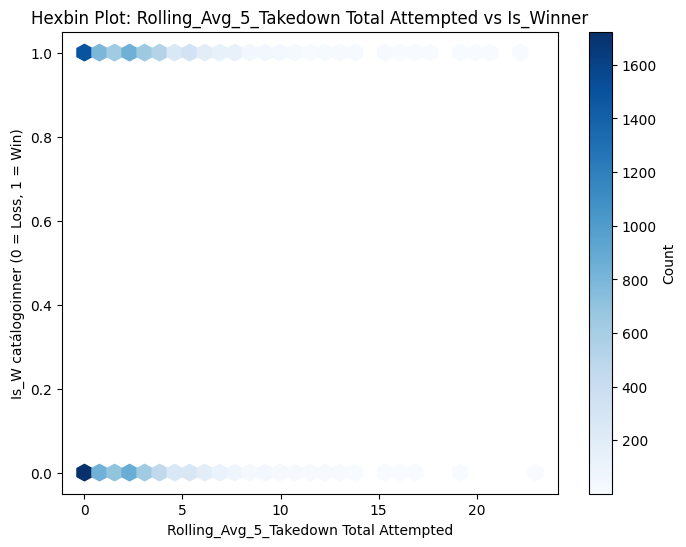

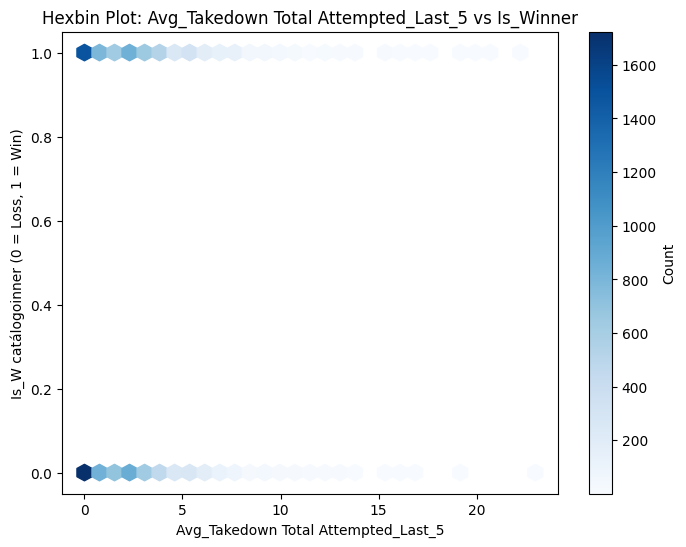

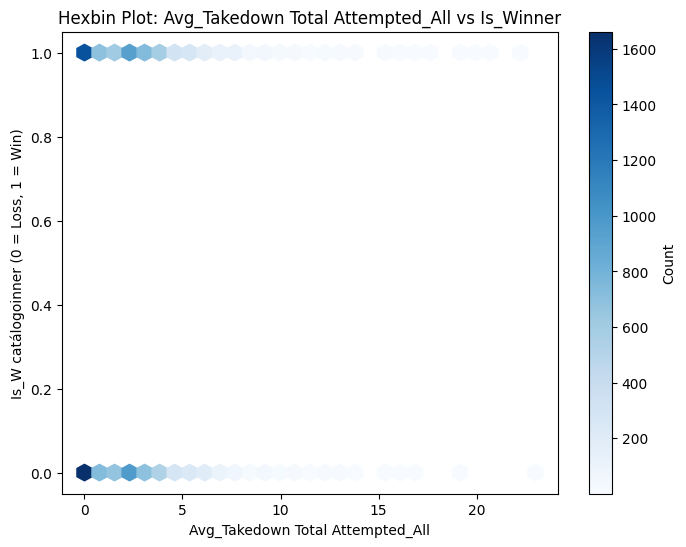

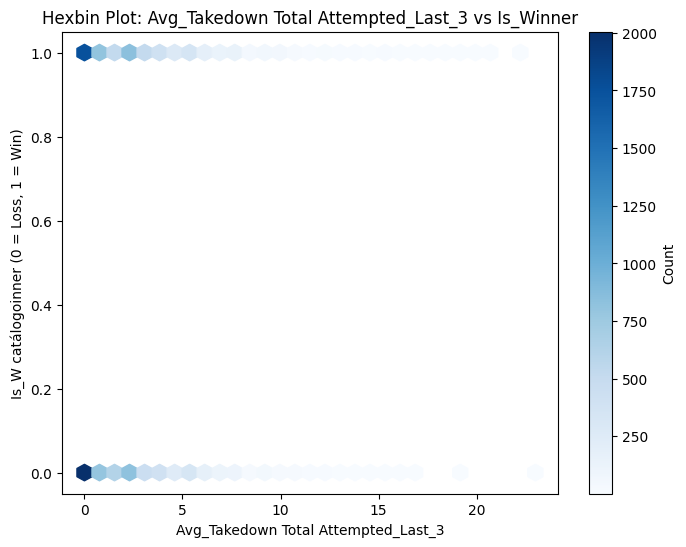

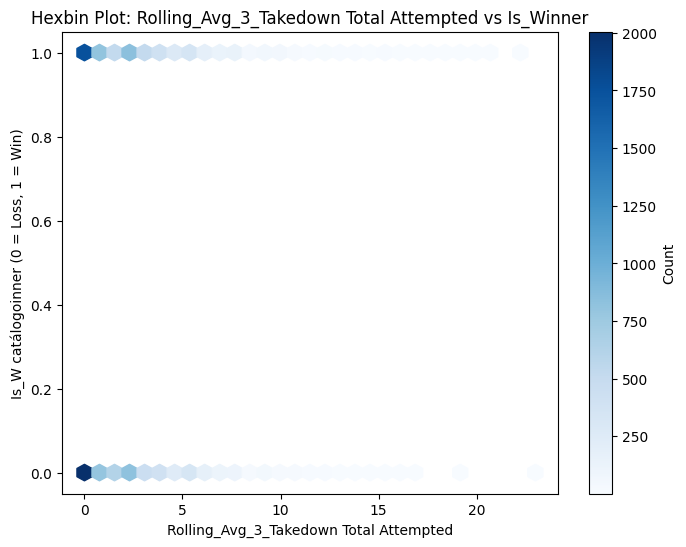


Pair Plot for Top 3 Features and Is_Winner:


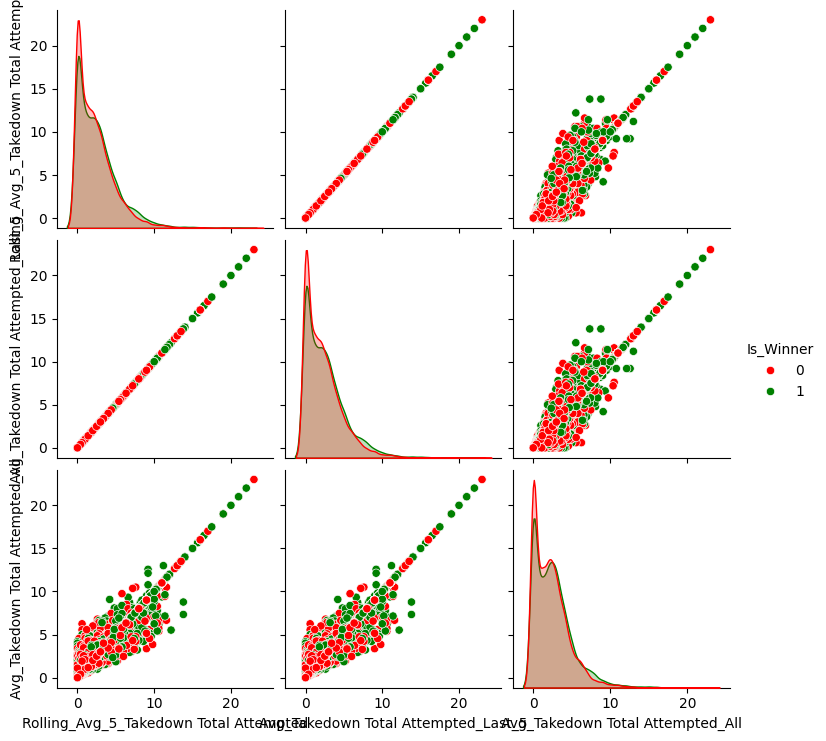


Interaction Analysis for Top 5 Features:
                                Feature 1  \
0  Rolling_Avg_5_Takedown Total Attempted   
1  Rolling_Avg_5_Takedown Total Attempted   
4     Avg_Takedown Total Attempted_Last_5   
2  Rolling_Avg_5_Takedown Total Attempted   
3  Rolling_Avg_5_Takedown Total Attempted   
5     Avg_Takedown Total Attempted_Last_5   
6     Avg_Takedown Total Attempted_Last_5   
7        Avg_Takedown Total Attempted_All   
8        Avg_Takedown Total Attempted_All   
9     Avg_Takedown Total Attempted_Last_3   

                                Feature 2  Spearman Correlation (Interaction)  
0     Avg_Takedown Total Attempted_Last_5                            0.059110  
1        Avg_Takedown Total Attempted_All                            0.057915  
4        Avg_Takedown Total Attempted_All                            0.057915  
2     Avg_Takedown Total Attempted_Last_3                            0.057290  
3  Rolling_Avg_3_Takedown Total Attempted                     

In [ ]:
result_df = pd.read_csv('/content/result_df_f.csv')
eda_results = eda_winner_vs_features_alternative_plots(result_df, feature_columns)


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import spearmanr
from itertools import combinations
from mpl_toolkits.mplot3d import Axes3D
from pandas.plotting import parallel_coordinates

%matplotlib inline

def eda_winner_vs_features_multivariate_plots(df, feature_columns, fighter_first_col='Fighter First Name',
                                              fighter_last_col='Fighter Last Name', winner_first_col='Winner First Name',
                                              winner_last_col='Winner Last Name', batch_size=5):
    # Validate and create Is_Winner column
    df['Is_Winner'] = ((df[fighter_first_col] == df[winner_first_col]) &
                       (df[fighter_last_col] == df[winner_last_col])).astype(int)

    # Check for missing winner names or potential draws
    missing_winner = df[[winner_first_col, winner_last_col]].isna().any(axis=1)
    if missing_winner.sum() > 0:
        print(f"Warning: {missing_winner.sum()} rows have missing winner names. These rows will be treated as losses (Is_Winner = 0).")

    potential_draws = df[~((df[fighter_first_col] == df[winner_first_col]) &
                           (df[fighter_last_col] == df[winner_last_col])) &
                         ~((df[fighter_first_col] != df[winner_first_col]) |
                           (df[fighter_last_col] != df[winner_last_col]))]
    if len(potential_draws) > 0:
        print(f"Warning: {len(potential_draws)} rows may represent draws or errors. Review these rows:")
        print(potential_draws[[fighter_first_col, fighter_last_col, winner_first_col, winner_last_col]])

    # Handle missing values and infinities
    df[feature_columns] = df[feature_columns].fillna(0)
    df[feature_columns] = df[feature_columns].replace([np.inf, -np.inf], 0)

    # Check for outliers using IQR
    outlier_counts = {}
    for col in feature_columns:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        outliers = df[(df[col] < (Q1 - 1.5 * IQR)) | (df[col] > (Q3 + 1.5 * IQR))][col]
        outlier_counts[col] = len(outliers)
    print("\nNumber of Outliers per Feature (Top 5):")
    outlier_counts = pd.Series(outlier_counts).sort_values(ascending=False)
    print(outlier_counts.head(5))

    # Compute summary statistics
    summary_stats = {}
    for col in feature_columns:
        stats = df.groupby('Is_Winner')[col].agg(['mean', 'median', 'std', 'min', 'max']).reset_index()
        summary_stats[col] = stats

    # Compute Spearman correlation with Is_Winner
    correlations = {}
    for col in feature_columns:
        corr, _ = spearmanr(df[col], df['Is_Winner'])
        correlations[col] = corr
    correlations = pd.Series(correlations).sort_values(ascending=False)
    correlations_df = pd.DataFrame({'Feature': correlations.index, 'Spearman Correlation': correlations.values})

    # KDE plots in batches
    num_features = len(feature_columns)
    num_plots = (num_features + batch_size - 1) // batch_size
    for i in range(num_plots):
        start_idx = i * batch_size
        end_idx = min((i + 1) * batch_size, num_features)
        batch_cols = feature_columns[start_idx:end_idx]

        fig, axes = plt.subplots(nrows=len(batch_cols), ncols=1, figsize=(10, 5 * len(batch_cols)))
        if len(batch_cols) == 1:
            axes = [axes]

        for j, col in enumerate(batch_cols):
            sns.kdeplot(data=df[df['Is_Winner'] == 0], x=col, label='Loss (0)', color='red', ax=axes[j])
            sns.kdeplot(data=df[df['Is_Winner'] == 1], x=col, label='Win (1)', color='green', ax=axes[j])
            axes[j].set_title(f'KDE Plot: {col} by Is_Winner')
            axes[j].set_xlabel(col)
            axes[j].set_ylabel('Density')
            axes[j].legend()

        plt.tight_layout()
        plt.show()

    # Expanded pair plot for top 5 features
    top_5_features = correlations_df['Feature'].head(5).tolist()
    pair_plot_cols = top_5_features + ['Is_Winner']
    print("\nPair Plot for Top 5 Features and Is_Winner (with Regression Lines):")
    g = sns.pairplot(df[pair_plot_cols], hue='Is_Winner', palette={0: 'red', 1: 'green'},
                     diag_kind='kde', plot_kws={'alpha': 0.5, 's': 50})  # Fixed plot_kws
    # Add regression lines to scatter plots
    for i in range(len(top_5_features)):
        for j in range(len(top_5_features)):
            if i != j:  # Skip diagonal
                ax = g.axes[i, j]
                sns.regplot(x=df[top_5_features[j]], y=df[top_5_features[i]], ax=ax, scatter=False, color='black')
    plt.show()

    # Correlation heatmap for top 10 features
    top_10_features = correlations_df['Feature'].head(10).tolist()
    print("\nCorrelation Heatmap for Top 10 Features:")
    corr_matrix = df[top_10_features].corr(method='spearman')
    plt.figure(figsize=(10, 8))
    sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1, center=0)
    plt.title('Spearman Correlation Heatmap of Top 10 Features')
    plt.show()

    # Parallel coordinates plot for top 5 features
    print("\nParallel Coordinates Plot for Top 5 Features:")
    parallel_cols = top_5_features + ['Is_Winner']
    plt.figure(figsize=(12, 6))
    parallel_coordinates(df[parallel_cols], 'Is_Winner', color=['red', 'green'], alpha=0.5)
    plt.title('Parallel Coordinates Plot of Top 5 Features by Is_Winner')
    plt.xlabel('Features')
    plt.ylabel('Feature Values (Normalized)')
    plt.legend(['Loss (0)', 'Win (1)'])
    plt.show()

    # 3D scatter plot for top 3 features
    top_3_features = correlations_df['Feature'].head(3).tolist()
    print("\n3D Scatter Plot for Top 3 Features:")
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')
    colors = df['Is_Winner'].map({0: 'red', 1: 'green'})
    ax.scatter(df[top_3_features[0]], df[top_3_features[1]], df[top_3_features[2]], c=colors, alpha=0.5)
    ax.set_xlabel(top_3_features[0])
    ax.set_ylabel(top_3_features[1])
    ax.set_zlabel(top_3_features[2])
    ax.set_title('3D Scatter Plot of Top 3 Features by Is_Winner')
    # Add a legend
    from matplotlib.lines import Line2D
    legend_elements = [Line2D([0], [0], marker='o', color='w', label='Loss (0)', markerfacecolor='red', markersize=10),
                       Line2D([0], [0], marker='o', color='w', label='Win (1)', markerfacecolor='green', markersize=10)]
    ax.legend(handles=legend_elements)
    plt.show()

    # Interaction analysis: Pairwise combinations of top 5 features
    print("\nInteraction Analysis for Top 5 Features:")
    interaction_results = []
    for col1, col2 in combinations(top_5_features, 2):
        interaction_term = df[col1] * df[col2]
        corr, _ = spearmanr(interaction_term, df['Is_Winner'])
        interaction_results.append({
            'Feature 1': col1,
            'Feature 2': col2,
            'Spearman Correlation (Interaction)': corr
        })
    interaction_df = pd.DataFrame(interaction_results).sort_values(by='Spearman Correlation (Interaction)', ascending=False)
    print(interaction_df)

    # Print summary statistics and correlations
    print("\nSummary Statistics for Top 5 Features by Spearman Correlation:")
    for col in top_5_features:
        print(f"\nFeature: {col}")
        print(summary_stats[col])

    print("\nTop 20 Features by Spearman Correlation with Is_Winner:")
    print(correlations_df.head(20))

    return {
        'Summary Statistics': summary_stats,
        'Correlations': correlations_df,
        'Interactions': interaction_df
    }



Number of Outliers per Feature (Top 5):
Submission Attempted_Wins            2142
Avg_Submission Attempted_Losses      2107
Avg_Winning Round_All                2032
Total_Submission Attempted_Last_5    1751
Avg_Submission Attempted_Last_3      1496
dtype: int64


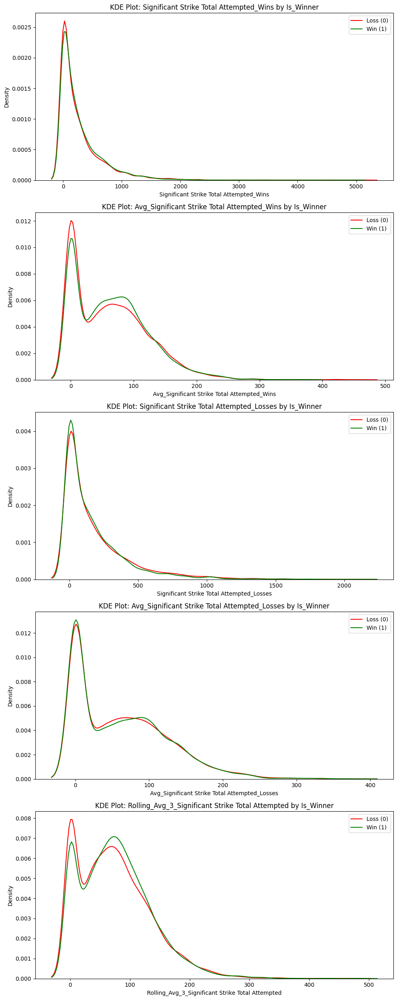

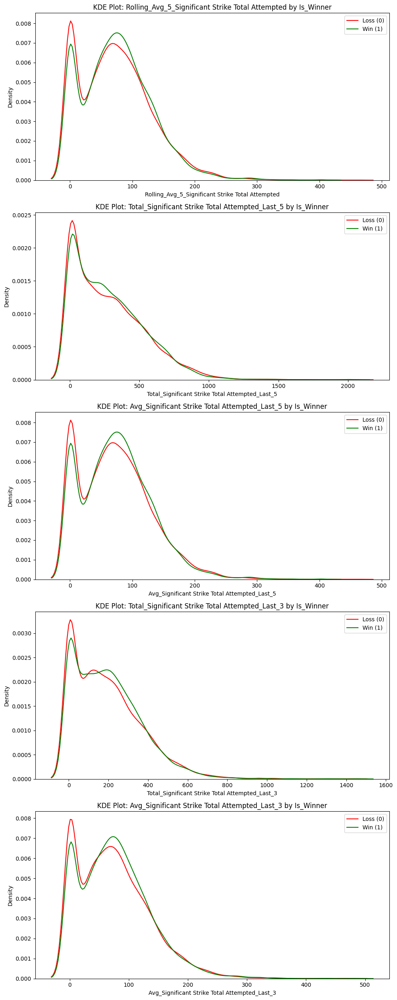

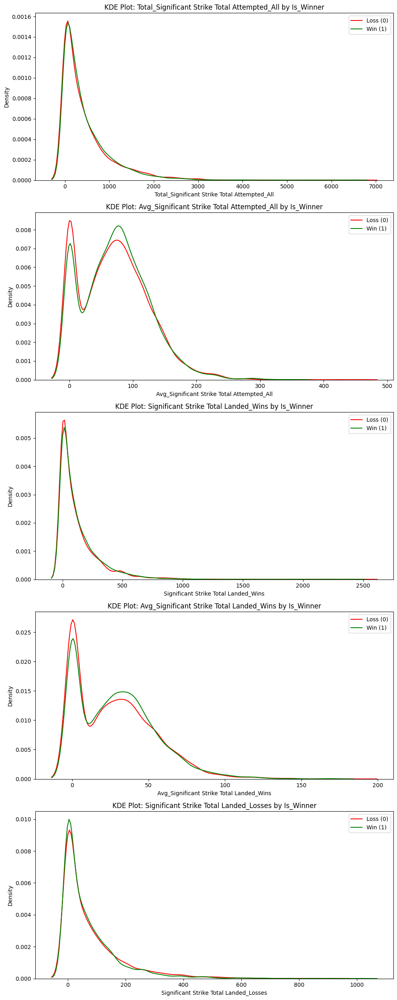

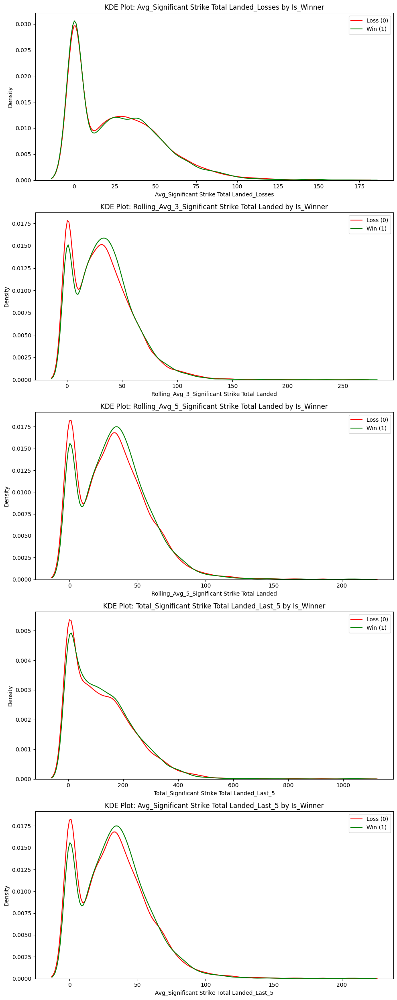

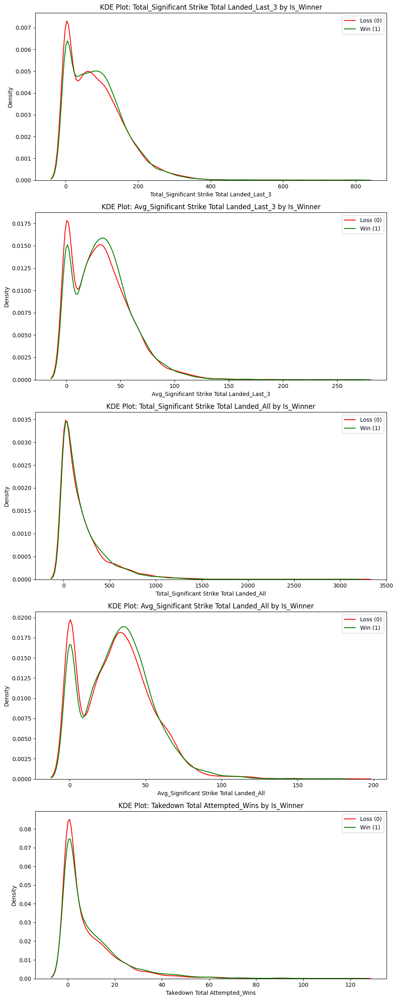

...

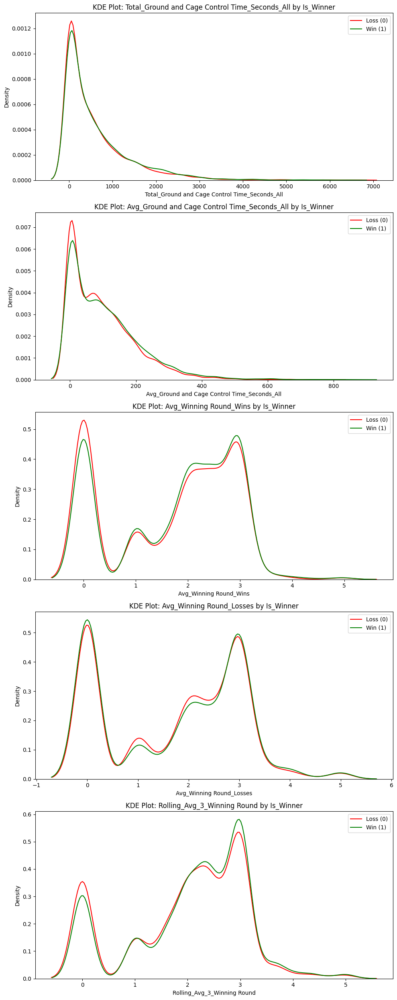

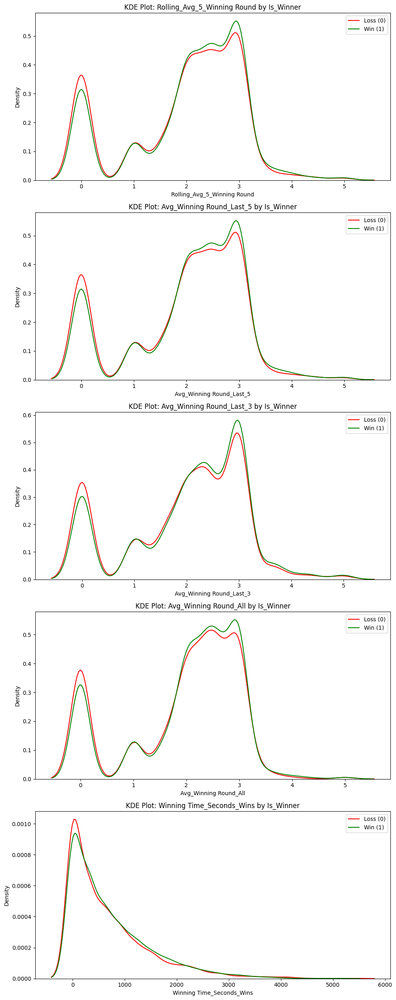

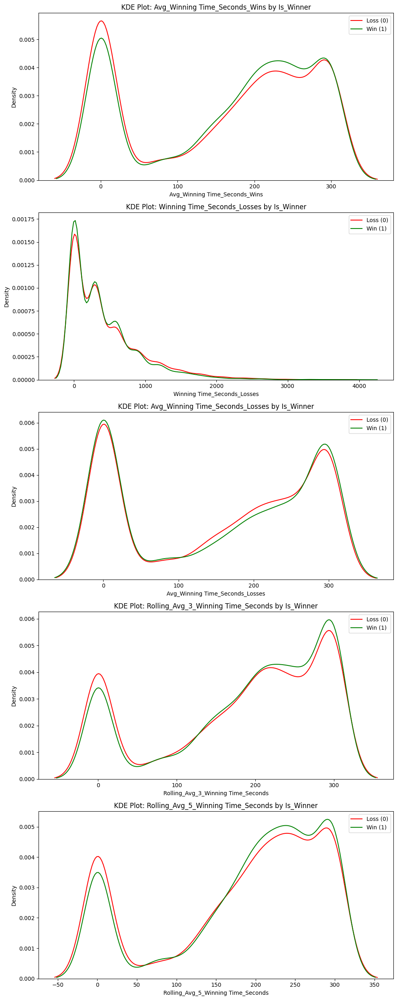

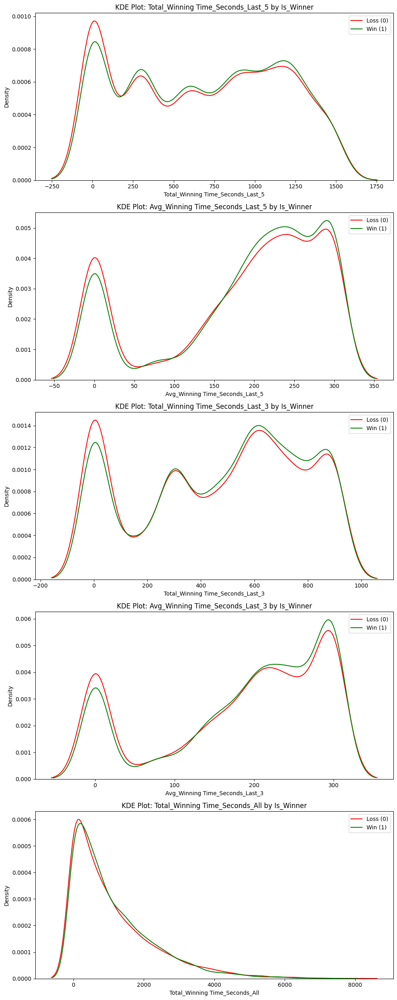

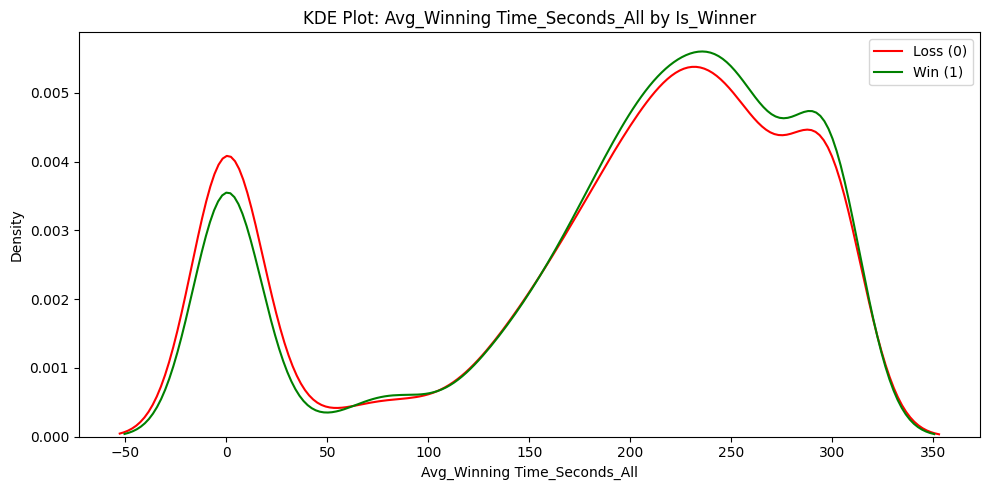


Pair Plot for Top 5 Features and Is_Winner (with Regression Lines):


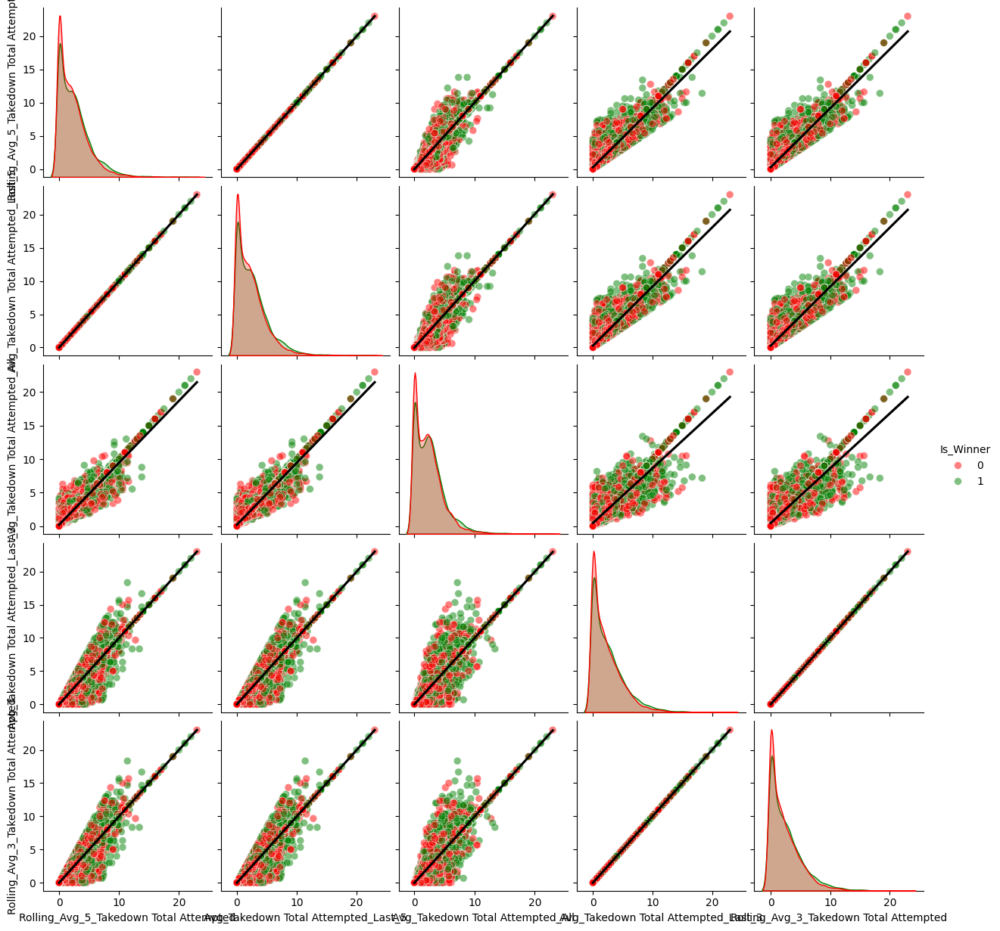


Correlation Heatmap for Top 10 Features:


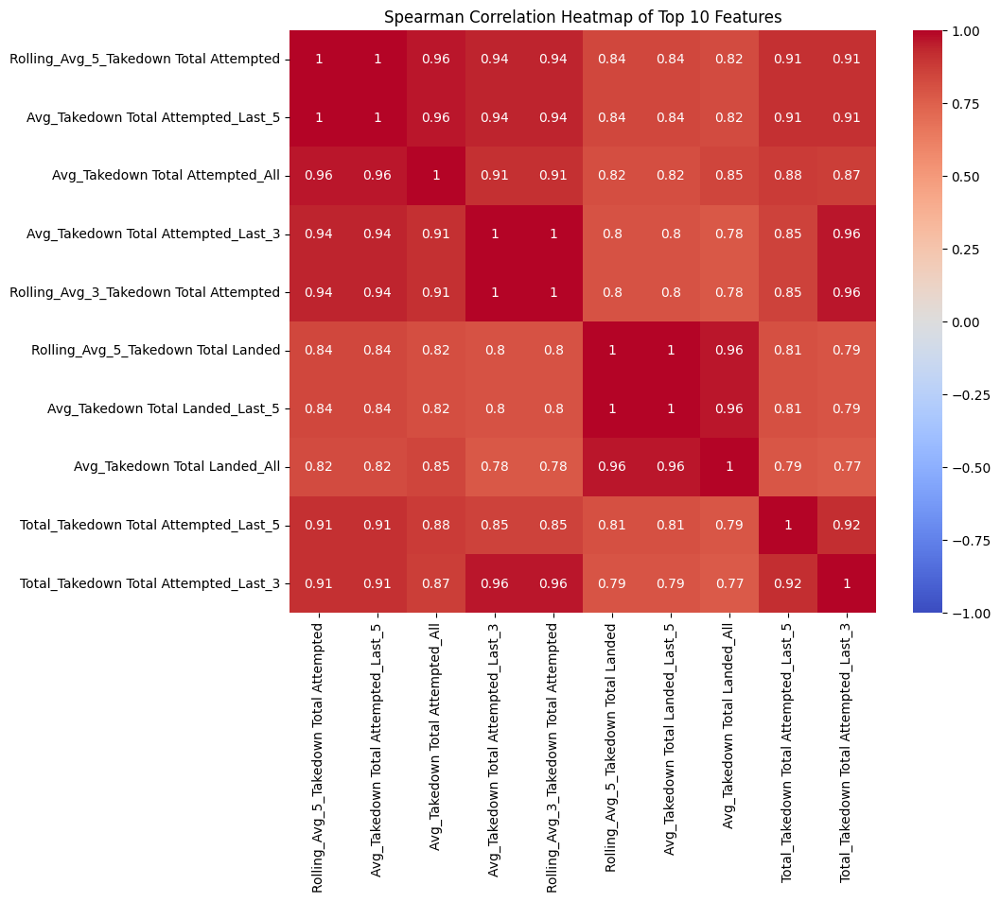


Parallel Coordinates Plot for Top 5 Features:


/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


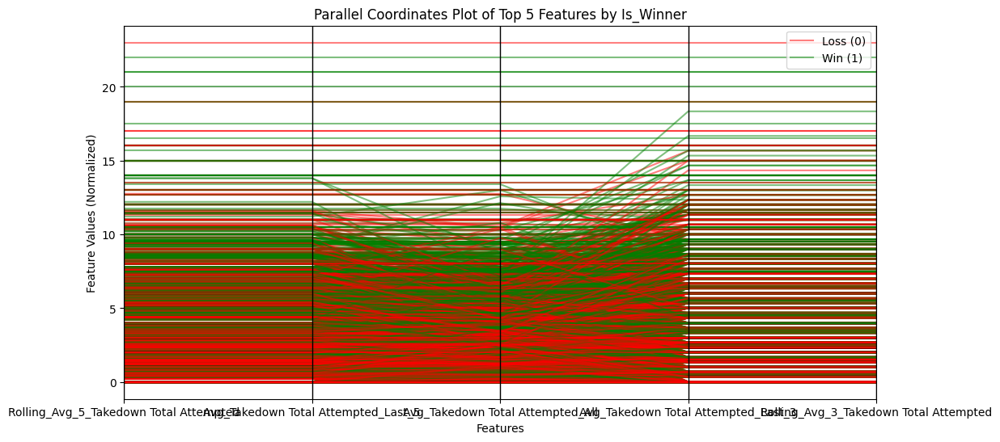


3D Scatter Plot for Top 3 Features:


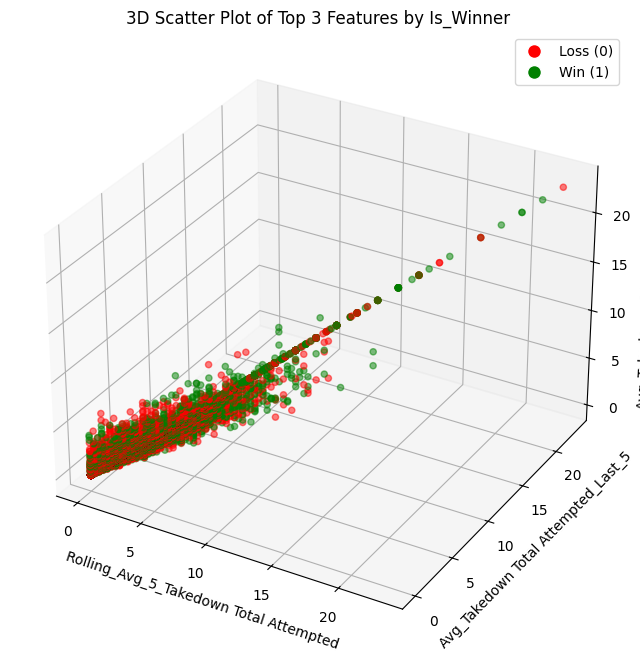


Interaction Analysis for Top 5 Features:
                                Feature 1  \
0  Rolling_Avg_5_Takedown Total Attempted   
1  Rolling_Avg_5_Takedown Total Attempted   
4     Avg_Takedown Total Attempted_Last_5   
2  Rolling_Avg_5_Takedown Total Attempted   
3  Rolling_Avg_5_Takedown Total Attempted   
5     Avg_Takedown Total Attempted_Last_5   
6     Avg_Takedown Total Attempted_Last_5   
7        Avg_Takedown Total Attempted_All   
8        Avg_Takedown Total Attempted_All   
9     Avg_Takedown Total Attempted_Last_3   

                                Feature 2  Spearman Correlation (Interaction)  
0     Avg_Takedown Total Attempted_Last_5                            0.059110  
1        Avg_Takedown Total Attempted_All                            0.057915  
4        Avg_Takedown Total Attempted_All                            0.057915  
2     Avg_Takedown Total Attempted_Last_3                            0.057290  
3  Rolling_Avg_3_Takedown Total Attempted                     

In [ ]:
eda_results = eda_winner_vs_features_multivariate_plots(result_df, feature_columns)


In [ ]:
result_df = pd.read_csv('/content/result_df_f.csv')


feature_columns = [
    'Significant Strike Total Attempted_Wins',
    'Avg_Significant Strike Total Attempted_Wins',
    'Significant Strike Total Attempted_Losses',
    'Avg_Significant Strike Total Attempted_Losses',
    'Rolling_Avg_3_Significant Strike Total Attempted',
    'Rolling_Avg_5_Significant Strike Total Attempted',
    'Total_Significant Strike Total Attempted_Last_5',
    'Avg_Significant Strike Total Attempted_Last_5',
    'Total_Significant Strike Total Attempted_Last_3',
    'Avg_Significant Strike Total Attempted_Last_3',
    'Total_Significant Strike Total Attempted_All',
    'Avg_Significant Strike Total Attempted_All',
    'Significant Strike Total Landed_Wins',
    'Avg_Significant Strike Total Landed_Wins',
    'Significant Strike Total Landed_Losses',
    'Avg_Significant Strike Total Landed_Losses',
    'Rolling_Avg_3_Significant Strike Total Landed',
    'Rolling_Avg_5_Significant Strike Total Landed',
    'Total_Significant Strike Total Landed_Last_5',
    'Avg_Significant Strike Total Landed_Last_5',
    'Total_Significant Strike Total Landed_Last_3',
    'Avg_Significant Strike Total Landed_Last_3',
    'Total_Significant Strike Total Landed_All',
    'Avg_Significant Strike Total Landed_All',
    'Takedown Total Attempted_Wins',
    'Avg_Takedown Total Attempted_Wins',
    'Takedown Total Attempted_Losses',
    'Avg_Takedown Total Attempted_Losses',
    'Rolling_Avg_3_Takedown Total Attempted',
    'Rolling_Avg_5_Takedown Total Attempted',
    'Total_Takedown Total Attempted_Last_5',
    'Avg_Takedown Total Attempted_Last_5',
    'Total_Takedown Total Attempted_Last_3',
    'Avg_Takedown Total Attempted_Last_3',
    'Total_Takedown Total Attempted_All',
    'Avg_Takedown Total Attempted_All',
    'Takedown Total Landed_Wins',
    'Avg_Takedown Total Landed_Wins',
    'Takedown Total Landed_Losses',
    'Avg_Takedown Total Landed_Losses',
    'Rolling_Avg_3_Takedown Total Landed',
    'Rolling_Avg_5_Takedown Total Landed',
    'Total_Takedown Total Landed_Last_5',
    'Avg_Takedown Total Landed_Last_5',
    'Total_Takedown Total Landed_Last_3',
    'Avg_Takedown Total Landed_Last_3',
    'Total_Takedown Total Landed_All',
    'Avg_Takedown Total Landed_All',
    'Submission Attempted_Wins',
    'Avg_Submission Attempted_Wins',
    'Submission Attempted_Losses',
    'Avg_Submission Attempted_Losses',
    'Rolling_Avg_3_Submission Attempted',
    'Rolling_Avg_5_Submission Attempted',
    'Total_Submission Attempted_Last_5',
    'Avg_Submission Attempted_Last_5',
    'Total_Submission Attempted_Last_3',
    'Avg_Submission Attempted_Last_3',
    'Total_Submission Attempted_All',
    'Avg_Submission Attempted_All',
    'Ground and Cage Control Time_Seconds_Wins',
    'Avg_Ground and Cage Control Time_Seconds_Wins',
    'Ground and Cage Control Time_Seconds_Losses',
    'Avg_Ground and Cage Control Time_Seconds_Losses',
    'Rolling_Avg_3_Ground and Cage Control Time_Seconds',
    'Rolling_Avg_5_Ground and Cage Control Time_Seconds',
    'Total_Ground and Cage Control Time_Seconds_Last_5',
    'Avg_Ground and Cage Control Time_Seconds_Last_5',
    'Total_Ground and Cage Control Time_Seconds_Last_3',
    'Avg_Ground and Cage Control Time_Seconds_Last_3',
    'Total_Ground and Cage Control Time_Seconds_All',
    'Avg_Ground and Cage Control Time_Seconds_All',
    'Avg_Winning Round_Wins',
    'Avg_Winning Round_Losses',
    'Rolling_Avg_3_Winning Round',
    'Rolling_Avg_5_Winning Round',
    'Avg_Winning Round_Last_5',
    'Avg_Winning Round_Last_3',
    'Avg_Winning Round_All',
    'Winning Time_Seconds_Wins',
    'Avg_Winning Time_Seconds_Wins',
    'Winning Time_Seconds_Losses',
    'Avg_Winning Time_Seconds_Losses',
    'Rolling_Avg_3_Winning Time_Seconds',
    'Rolling_Avg_5_Winning Time_Seconds',
    'Total_Winning Time_Seconds_Last_5',
    'Avg_Winning Time_Seconds_Last_5',
    'Total_Winning Time_Seconds_Last_3',
    'Avg_Winning Time_Seconds_Last_3',
    'Total_Winning Time_Seconds_All',
    'Avg_Winning Time_Seconds_All'
]

<ipython-input-27-0a7952c4c54b>:1: DtypeWarning: Columns (7,25,43,61,79,97,115) have mixed types. Specify dtype option on import or set low_memory=False.
  result_df = pd.read_csv('/content/result_df_f.csv')


In [ ]:
# Create target column (1 if fighter won, 0 otherwise)
df['Is_Winner'] = (
    (df['Fighter First Name'] == df['Winner First Name']) &
    (df['Fighter Last Name'] == df['Winner Last Name'])
).astype(int)

# Verify the column exists
print("Target column created. Value counts:")
print(df['Is_Winner'].value_counts())

import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score

# 1. Define target and numerical features (excluding round-specific and non-numeric)
target = 'Is_Winner'
numerical_features = [
    'Height Inches', 'Weight Pounds', 'Reach Inches',
    'Knockdown Total',
    'Significant Strike Total Attempted', 'Significant Strike Total Landed',
    'Takedown Total Attempted', 'Takedown Total Landed',
    'Submission Attempted', 'Reversal',
    'Ground and Cage Control Time_Seconds',
    'Significant Strike Head Attempted', 'Significant Strike Head Landed',
    'Significant Strike Body Attempted', 'Significant Strike Body Landed',
    'Significant Strike Leg Attempted', 'Significant Strike Leg Landed',
    'Significant Strike Clinch Attempted', 'Significant Strike Clinch Landed',
    'Significant Strike Ground Attempted', 'Significant Strike Ground Landed'
]

# 2. Filter only existing numerical features in DataFrame
valid_features = [col for col in numerical_features if col in df.columns and pd.api.types.is_numeric_dtype(df[col])]
print(f"Using {len(valid_features)} numerical features")

# 3. Handle missing data
X = df[valid_features].fillna(0).replace([np.inf, -np.inf], 0)
y = df[target]

# 4. Feature Selection - Select top 10 most predictive features
selector = SelectKBest(f_classif, k=min(10, len(valid_features)))
X_selected = selector.fit_transform(X, y)
selected_mask = selector.get_support()
selected_features = X.columns[selected_mask]

print("\nTop 10 Selected Features:")
print(selected_features.tolist())

# 5. Train/Test Split
X_train, X_test, y_train, y_test = train_test_split(
    X[selected_features], y, test_size=0.2, random_state=42
)

# 6. Train Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# 7. Evaluate
train_acc = accuracy_score(y_train, model.predict(X_train))
test_acc = accuracy_score(y_test, model.predict(X_test))
print(f"\nTraining Accuracy: {train_acc:.4f}")
print(f"Test Accuracy: {test_acc:.4f}")

# 8. Feature Importance
importance = pd.DataFrame({
    'Feature': selected_features,
    'Importance': model.feature_importances_
}).sort_values('Importance', ascending=False)

print("\nFeature Importances:")
print(importance)

Target column created. Value counts:
Is_Winner
0    6285
1    6223
Name: count, dtype: int64
Using 20 numerical features

Top 10 Selected Features:
['Reach Inches', 'Significant Strike Total Landed', 'Takedown Total Attempted', 'Takedown Total Landed', 'Submission Attempted', 'Significant Strike Head Landed', 'Significant Strike Body Attempted', 'Significant Strike Body Landed', 'Significant Strike Ground Attempted', 'Significant Strike Ground Landed']

Training Accuracy: 0.9926
Test Accuracy: 0.5356

Feature Importances:
                               Feature  Importance
0                         Reach Inches    0.163900
1      Significant Strike Total Landed    0.163857
5       Significant Strike Head Landed    0.151966
6    Significant Strike Body Attempted    0.122029
7       Significant Strike Body Landed    0.106164
2             Takedown Total Attempted    0.082870
8  Significant Strike Ground Attempted    0.077206
9     Significant Strike Ground Landed    0.065033
3            